# Challenge
Unsupervised learning is one of the major learning paradigms in machine learning and it enables us to understand the patterns and relationships in the data without the guidance of ground truths in the data. Although many of the recent breakthroughs in machine learning in the previous decades came from the supervised learning front, unsupervised learning remains one of the most promising directions that the current data science and artificial intelligence can make use of. Although, we're living in a world with abundant amounts of data, labeling them with the ground truths is not an easy task as many times this requires costly and challenging human labor to annotate them. Unsupervised learning is of primary importance for data science as it has the potential to exploit enormous amounts of data without any need for annotation.

## Challenge
Throughout this module, we introduced the amazing and yet challenging domain of unsupervised learning by covering some of the most popular clustering and dimensionality reduction algorithms. Now, it's time for you to apply your unsupervised learning knowledge. In this challenge, you'll work with a dataset of your choice. As always, Kaggle is one of your best friends. You can spend some time on Kaggle and pick a beautiful dataset. Using this dataset:

- Apply dimensionality reduction techniques to visualize the observations.
- Apply clustering techniques to group together similar observations.

In each of the tasks above, try alternative methods and select a best performing one. Discuss how dimensionality reduction and clustering algorithms enable you to gain insights regarding the data.

### Note for the reader

The lion share of this notebook is dedicated to EDA, data cleaning, and feature engineering. This data set was from an older assignment in order to prep for modeling. 
If you would like to skip to the unsupervised learning portion, then feel free to scroll down ~2/3 of the way. <br>
It will be clearly labeled as to where the unsupervised section begins.

In [1]:
# Import SQL Alchemy engine
from sqlalchemy import create_engine

# Import dataframe/number packages
import pandas as pd
import numpy as np
from numpy.random import rand
from matplotlib.colors import Normalize
from matplotlib import gridspec
%matplotlib inline
import time

# Import plotting packages
import matplotlib.pyplot as plt
import seaborn as sns

# Import stat packages
from scipy.stats import jarque_bera
from scipy.stats import normaltest
from scipy.stats.stats import ttest_ind
from scipy.stats.mstats import winsorize
from scipy.stats import zscore
import scipy.stats as stats
from scipy.stats import boxcox
from itertools import product

# dimensionality reduction methods
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap

from sklearn.preprocessing import StandardScaler, scale
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.metrics import silhouette_score

from matplotlib.colors import Normalize
from matplotlib import gridspec
from sklearn.preprocessing import LabelEncoder
from sklearn.neighbors import NearestNeighbors

# clustering models
from sklearn.mixture import GaussianMixture
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.stats import norm
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans, MiniBatchKMeans

#pd.reset_option('display.float_format')
pd.set_option('display.max_columns', 999)
pd.set_option('display.max_rows', 999)

# Shutup Warnings!
import warnings
warnings.filterwarnings('ignore')

###  First, load the dataset.

In [2]:
df_life_expectancy = pd.read_csv('Life Expectancy Data.csv')

## Data Exploration

Let's learn some of the high-level nature of the data set

In [3]:
# number of rows, columns
df_life_expectancy.shape

(2938, 22)

In [4]:
# Find all info - rows, dtype, non-null value counts per column
df_life_expectancy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2938 entries, 0 to 2937
Data columns (total 22 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Country                          2938 non-null   object 
 1   Year                             2938 non-null   int64  
 2   Status                           2938 non-null   object 
 3   Life expectancy                  2928 non-null   float64
 4   Adult Mortality                  2928 non-null   float64
 5   infant deaths                    2938 non-null   int64  
 6   Alcohol                          2744 non-null   float64
 7   percentage expenditure           2938 non-null   float64
 8   Hepatitis B                      2385 non-null   float64
 9   Measles                          2938 non-null   int64  
 10   BMI                             2904 non-null   float64
 11  under-five deaths                2938 non-null   int64  
 12  Polio               

In [5]:
# random sampling of all columns and 5 rows of data
pd.set_option('display.max_columns', 999)
df_life_expectancy.sample(5)

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,under-five deaths,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
1163,Hungary,2006,Developed,73.4,177.0,1,13.16,1299.459306,NaN,1,59.3,1,99.0,8.10,99.0,0.1,11398.76584,17137.0,2.0,2.0,0.802,15.2
2561,Tajikistan,2007,Developing,66.1,181.0,10,0.35,2.272405,84.0,2,34.7,12,85.0,5.35,86.0,0.3,52.35956,7152385.0,3.8,3.8,0.586,10.9
1834,Netherlands,2010,Developed,88.0,64.0,1,9.33,1035.621437,NaN,15,59.3,1,97.0,1.48,97.0,0.1,5338.25483,16615394.0,1.0,0.9,0.906,17.0
1838,Netherlands,2006,Developed,79.8,71.0,1,9.79,8344.010392,NaN,1,56.5,1,96.0,9.36,96.0,0.1,44453.97119,1634611.0,1.0,1.0,0.893,16.5
982,Georgia,2011,Developing,73.9,127.0,1,8.14,198.948760,89.0,64,52.8,1,88.0,9.38,94.0,0.1,3725.63221,3875.0,2.6,2.8,0.742,13.3


In [6]:
# look at all stats for all dtypes
df_life_expectancy.describe(include = 'all')

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,under-five deaths,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
count,2938,2938.000000,2938,2928.000000,2928.000000,2938.000000,2744.000000,2938.000000,2385.000000,2938.000000,2904.000000,2938.000000,2919.000000,2712.00000,2919.000000,2938.000000,2490.000000,2.286000e+03,2904.000000,2904.000000,2771.000000,2775.000000
unique,193,NaN,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,Ethiopia,NaN,Developing,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,16,NaN,2426,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,2007.518720,NaN,69.224932,164.796448,30.303948,4.602861,738.251295,80.940461,2419.592240,38.321247,42.035739,82.550188,5.93819,82.324084,1.742103,7483.158469,1.275338e+07,4.839704,4.870317,0.627551,11.992793
std,NaN,4.613841,NaN,9.523867,124.292079,117.926501,4.052413,1987.914858,25.070016,11467.272489,20.044034,160.445548,23.428046,2.49832,23.716912,5.077785,14270.169342,6.101210e+07,4.420195,4.508882,0.210904,3.358920
min,NaN,2000.000000,NaN,36.300000,1.000000,0.000000,0.010000,0.000000,1.000000,0.000000,1.000000,0.000000,3.000000,0.37000,2.000000,0.100000,1.681350,3.400000e+01,0.100000,0.100000,0.000000,0.000000
25%,NaN,2004.000000,NaN,63.100000,74.000000,0.000000,0.877500,4.685343,77.000000,0.000000,19.300000,0.000000,78.000000,4.26000,78.000000,0.100000,463.935626,1.957932e+05,1.600000,1.500000,0.493000,10.100000
50%,NaN,2008.000000,NaN,72.100000,144.000000,3.000000,3.755000,64.912906,92.000000,17.000000,43.500000,4.000000,93.000000,5.75500,93.000000,0.100000,1766.947595,1.386542e+06,3.300000,3.300000,0.677000,12.300000
75%,NaN,2012.000000,NaN,75.700000,228.000000,22.000000,7.702500,441.534144,97.000000,360.250000,56.200000,28.000000,97.000000,7.49250,97.000000,0.800000,5910.806335,7.420359e+06,7.200000,7.200000,0.779000,14.300000


In [7]:
# determine which columns are likely categorical vs continuous variables
# look at the lower numbers to recognize potential categorical variables
df_life_expectancy.nunique().sort_values()

Status                                2
Year                                 16
Polio                                73
Diphtheria                           81
Hepatitis B                          87
Schooling                           173
Country                             193
 HIV/AIDS                           200
 thinness  1-19 years               200
 thinness 5-9 years                 207
infant deaths                       209
under-five deaths                   252
Life expectancy                     362
Adult Mortality                     425
 BMI                                608
Income composition of resources     625
Total expenditure                   818
Measles                             958
Alcohol                            1076
Population                         2278
percentage expenditure             2328
GDP                                2490
dtype: int64

Just from the little bit, we learned there are definitely nulls, some of the data is categorical, and the column names are labeled inconsistently. Let's move on to clean up the labels, nulls, and outliers.

## Data Cleanup

In this section I will identify and correct the nulls and outliers. <br> In addition, there may be some need to determine the validity of the data in the dataframe and some basic formating.

In [8]:
# new dataframe to avoid changing original dataset
df_life_expectancy_2 = df_life_expectancy.copy()

Need to clean up column names and possibly clean up row values.

In [9]:
# general clean up script that was used in previous exercise. Normalizes column names and removes special characters
spec_chars = ['__', ',', '(', ')', '/', '.', '"', '-', ' ', '  ']

# fewer required characters with for loop vs method chaining
for char in spec_chars:
    df_life_expectancy_2.columns = df_life_expectancy_2.columns.str.replace(char, ' ')

# needed to do this str.replace method separate from above because it took 2 runs of the code to work and that's not intuitive for users
df_life_expectancy_2.columns = df_life_expectancy_2.columns.str.strip().str.lower().str.replace(' ', '_')

# noticed that some of these columns are age, rates, and percentages. renaming for clarification
df_life_expectancy_2.rename(columns={'life_expectancy':'life_expectancy_age', 'adult_mortality':'adult_mortality_rate', 'hepatitis_b':'hepatitis_b_perc', 'polio':'polio_perc', 'total_expenditure':'total_expenditure_perc', 'diphtheria':'diphtheria_perc', 'thinness_1_19_years':'thinness_1_19_years_perc', 'thinness_5_9_years':'thinness_5_9_years_perc'}, inplace=True)

print(df_life_expectancy_2.columns)

Index(['country', 'year', 'status', 'life_expectancy_age',
       'adult_mortality_rate', 'infant_deaths', 'alcohol',
       'percentage_expenditure', 'hepatitis_b_perc', 'measles', 'bmi',
       'under_five_deaths', 'polio_perc', 'total_expenditure_perc',
       'diphtheria_perc', 'hiv_aids', 'gdp', 'population',
       'thinness_1_19_years_perc', 'thinness_5_9_years_perc',
       'income_composition_of_resources', 'schooling'],
      dtype='object')


It's possible the columns with the fewest unique values are categorical in nature. Let's take a look at each one to see if there are any inconsistencies. 

In [10]:
# Out of the categorical data, lets see if any of the country column has any inconsistencies. 
df_life_expectancy_2.country.value_counts()

Ethiopia                                                16
Mali                                                    16
Congo                                                   16
Bangladesh                                              16
Libya                                                   16
Viet Nam                                                16
Armenia                                                 16
Suriname                                                16
Lesotho                                                 16
Iran (Islamic Republic of)                              16
United Arab Emirates                                    16
Tajikistan                                              16
Eritrea                                                 16
Kyrgyzstan                                              16
Mauritius                                               16
Swaziland                                               16
Micronesia (Federated States of)                        

The frequency of most countries in the data set is 16. There are some countries with only 1 entry (scroll the bottom), which means these can negatively impact the model because they don't represent the bulk of the data. Let's drop them and see what happens.

In [11]:
# drops countries that are not listed 16 times
vc = df_life_expectancy_2['country'].value_counts()
u  = [i in set(vc[vc==16].index) for i in df_life_expectancy_2['country']]
df_life_expectancy_3 = df_life_expectancy_2[u]
df_life_expectancy_3.country.value_counts()

Ethiopia                                                16
Jordan                                                  16
Fiji                                                    16
Congo                                                   16
Bangladesh                                              16
Libya                                                   16
Viet Nam                                                16
Armenia                                                 16
Suriname                                                16
Lesotho                                                 16
Vanuatu                                                 16
Iran (Islamic Republic of)                              16
United Arab Emirates                                    16
Mali                                                    16
Tajikistan                                              16
Kyrgyzstan                                              16
Mauritius                                               

Only countries with 16 entries remain in the dataframe.

In [12]:
# dropped 10 out of 2938 rows from this clean up effort
print("The dataframe shape is now " + str(df_life_expectancy_3.shape))
print("We dropped " + str(len(df_life_expectancy_2) - len(df_life_expectancy_3)) + " rows from the dataframe.")

The dataframe shape is now (2928, 22)
We dropped 10 rows from the dataframe.


In [13]:
# Checking for labeling errors within 'status' column
print(df_life_expectancy_3.status.value_counts())
print(df_life_expectancy_3.year.value_counts().sort_index())

Developing    2416
Developed      512
Name: status, dtype: int64
2000    183
2001    183
2002    183
2003    183
2004    183
2005    183
2006    183
2007    183
2008    183
2009    183
2010    183
2011    183
2012    183
2013    183
2014    183
2015    183
Name: year, dtype: int64


### Nulls

Now that some basic features are fixed, let's move on to identifying and eliminating nulls where reasonable.


In [14]:
# Count how many nulls there are per column
total_nulls = df_life_expectancy_3.isna().sum()
total_nulls.sort_values(inplace=True, ascending = False)

# Observe the percentage of nulls in each column
percent_nulls = df_life_expectancy_3.isna().sum()* 100 / len(df_life_expectancy_3)
percent_nulls.sort_values(inplace=True, ascending = False)

print('total nulls per column')
print(total_nulls)
print('------------------------\npercent nulls per column')
print(percent_nulls)

total nulls per column
population                         644
hepatitis_b_perc                   553
gdp                                443
total_expenditure_perc             226
alcohol                            193
schooling                          160
income_composition_of_resources    160
bmi                                 32
thinness_1_19_years_perc            32
thinness_5_9_years_perc             32
diphtheria_perc                     19
polio_perc                          19
under_five_deaths                    0
hiv_aids                             0
measles                              0
percentage_expenditure               0
infant_deaths                        0
adult_mortality_rate                 0
life_expectancy_age                  0
status                               0
year                                 0
country                              0
dtype: int64
------------------------
percent nulls per column
population                         21.994536
hepatitis_b

There seems to be some large null values. Let's take a look at some of them to see what the issues may be.

In [15]:
# I want to see all the data easily. 
#pd.set_option('display.max_rows', None)

# Rounds the values instead of reading scientific notation.
pd.set_option('display.float_format', lambda x: '%.2f' % x)

In [16]:
# Some countries have missing numbers, while others (like the USA) have no entries for population at all.
df_life_expectancy_3[['population','year', 'country']]

,population,year,country
0,33736494.00,2015,Afghanistan
1,327582.00,2014,Afghanistan
2,31731688.00,2013,Afghanistan
3,3696958.00,2012,Afghanistan
4,2978599.00,2011,Afghanistan
...,...,...,...
2933,12777511.00,2004,Zimbabwe
2934,12633897.00,2003,Zimbabwe
2935,125525.00,2002,Zimbabwe
2936,12366165.00,2001,Zimbabwe


In [17]:
# 2015 is a year that alcohol and total_expenditure_perc are not reported for many countries. 

df_life_expectancy_3[['total_expenditure_perc', 'year', 'country']]

,total_expenditure_perc,year,country
0,8.16,2015,Afghanistan
1,8.18,2014,Afghanistan
2,8.13,2013,Afghanistan
3,8.52,2012,Afghanistan
4,7.87,2011,Afghanistan
...,...,...,...
2933,7.13,2004,Zimbabwe
2934,6.52,2003,Zimbabwe
2935,6.53,2002,Zimbabwe
2936,6.16,2001,Zimbabwe


In [18]:
# Make a list of columns with nulls. 
fill_list = ['alcohol', 'hepatitis_b_perc', 'percentage_expenditure', 'total_expenditure_perc', 'population', 'gdp', 'bmi', 'thinness_5_9_years_perc', 'thinness_1_19_years_perc', 'diphtheria_perc', 'polio_perc']

Since there are various forms of missing data, it seems prudent to use the mean method to fill nulls by using the "country" column for reference. This should allow incomplete entries for variables to be estimated by unique countries (instead of aimlessly using the entire column), and avoid arbitrarily assigning values not relevant for that country. This should also prevent countries with zero entries for a given variable from being populated with erroneous data. 

No countries will be deleted at this point, even though there will still be nulls in some variables. Without knowing what variables are important, it could negatively impact the study to delete countries that lack 100% of the data.

In [19]:
# Fill in nulls with mean values for each attribute, grouped by country.
# Takes forever to run!
countries = df_life_expectancy_3["country"].unique()

for col in fill_list:
    for country in countries:
        df_life_expectancy_3.loc[df_life_expectancy_3["country"] == country, col] = df_life_expectancy_3.loc[df_life_expectancy_3["country"] == country, col].fillna(
            df_life_expectancy_3[df_life_expectancy_3["country"] == country][col].mean())

In [20]:
# How did the previous method work?
# Count how many nulls there are per column
total_nulls = df_life_expectancy_3.isna().sum()
total_nulls.sort_values(inplace=True, ascending = False)


print('total nulls per column')
print(total_nulls)

total nulls per column
population                         640
gdp                                400
schooling                          160
income_composition_of_resources    160
hepatitis_b_perc                   144
total_expenditure_perc              32
bmi                                 32
thinness_1_19_years_perc            32
thinness_5_9_years_perc             32
alcohol                             16
diphtheria_perc                      0
hiv_aids                             0
polio_perc                           0
under_five_deaths                    0
measles                              0
percentage_expenditure               0
infant_deaths                        0
adult_mortality_rate                 0
life_expectancy_age                  0
status                               0
year                                 0
country                              0
dtype: int64


We still have many nulls left. Fun fact, all of these nulls are divisible by 16, which is the number of rows that accounts for each country. This is because the only nulls remaining are those that have complete missing data for a variable in a given country. Therefore, grouping by country and inserting the mean value was not effective for these cases. There's a couple more concepts to apply in order to remove these nulls.
Looking through the data, it's apparant a couple, small countries have nulls where no other country does. This is represented by the variables with few nulls. These will simply be deleted. 

Also, there are larger fish to fry and we don't want to randomly delete a significant portion of the dataset by simply using a broad stroke method like "fill na". An assumption can be made that suggests the controls of many of these attributes are (in part) determined by whether the country is designated as "Developed" or "Developing". Grouping each variable by "Status" and applying a mean value might be a "good-enough" approach to infill missing portions of the dataset. This was also validated in the work further down where we run ttests on "status".

The exclusion to this rule will be the "Population" variable. The reporting of available population numbers by year vary so much that it's impossible to determine what's accurate. China and India are prime examples of this issue, where their populations swing up and down dramatically. In the real world, I would have researched populations from a different source and overwritten the data here. This column will eventually be dropped.

In order to use "status" as our guideline, we must believe this column to be as accurate as possible. Using "income_composition_of_resources", let's see if there are any basic mistakes and correct this first.

In [21]:
df_life_expectancy_3.groupby(['country','status'])['income_composition_of_resources'].mean().sort_values(ascending = False)

country                                               status    
Norway                                                Developed    0.93
Australia                                             Developed    0.92
Switzerland                                           Developed    0.91
Denmark                                               Developed    0.90
Netherlands                                           Developed    0.90
Germany                                               Developed    0.89
Sweden                                                Developed    0.89
Canada                                                Developing   0.89
Ireland                                               Developed    0.89
New Zealand                                           Developed    0.89
Iceland                                               Developed    0.89
Luxembourg                                            Developed    0.88
Belgium                                               Developed    0.88

Countries like Canada and France are recorded as developing countries. This isn't correct. Referring to the UN classifications for developed countries, it's clear that there are multiple errors in the "status" column. Using the list from the UN as guidance, a bulk of errors occur at and above 0.84 in the "income_composition_of_resources" column. Let's reassign the correct status to the appropriate countries. This is a shotgun approach, but should correct enough errors for this purpose.

In [22]:
# Transform status of high income comp of resources from "developing" to "developed" status
df_life_expectancy_3.loc[df_life_expectancy_3.income_composition_of_resources >= 0.84, 'status'] = "Developed"

Next, lets go ahead and group by status and fill in the means of the missing values.
The next few rows of code are for basic cross checks.

In [23]:
df_life_expectancy_3.groupby('status')['percentage_expenditure'].mean()

status
Developed    2707.60
Developing    226.90
Name: percentage_expenditure, dtype: float64

In [24]:
df_life_expectancy_3.groupby('status')['income_composition_of_resources'].mean()

status
Developed    0.86
Developing   0.57
Name: income_composition_of_resources, dtype: float64

In [25]:
df_life_expectancy_3.groupby('status')['schooling'].mean()

status
Developed    15.87
Developing   11.02
Name: schooling, dtype: float64

In [26]:
# Finding the significance of difference of Average_Life_Expectancy between Developed and Developing countries using 
# t-test

stats.ttest_ind(df_life_expectancy_3.loc[df_life_expectancy_3['status']=='Developed','life_expectancy_age'],df_life_expectancy_3.loc[df_life_expectancy_3['status']=='Developing','life_expectancy_age'])

Ttest_indResult(statistic=35.46975719819496, pvalue=1.5287333827780653e-229)

It appears status is a statistically significant feature with reference to the target variable.

In [27]:
# list of columns with null values
null_list = ['bmi', 'thinness_5_9_years_perc', 'thinness_1_19_years_perc', 'gdp', 'total_expenditure_perc', 'alcohol', 'percentage_expenditure', 'income_composition_of_resources', 'schooling', 'hepatitis_b_perc']

In [28]:
# this script takes columns from a provided list, groups by "status", then averages the variable based on the status of that country.
# The infill of the data will be a broad average, but will hopefully be good enough based on the macro trends.
for col in null_list:
    df_life_expectancy_3[col] = df_life_expectancy_3[col].fillna(df_life_expectancy_3.groupby('status')[col].transform('mean'))

Dropping "population" for reasons listed above.

In [29]:
df_life_expectancy_4 = df_life_expectancy_3.copy()

In [30]:
df_life_expectancy_4 = df_life_expectancy_4.drop(['population'], axis = 1)

Notice some numeric data is float64 and int64. It might be simpler if all numeric columns are floats. Leaving out 'year' and 'life_expectancy_age' because they are categorical variables and might need to be treated differently.

In [31]:
# Change int64 to float64 except for 'year'
df_life_expectancy_4[['infant_deaths', 'measles', 'under_five_deaths']] = df_life_expectancy_4[['infant_deaths', 'measles', 'under_five_deaths']].astype(float)
#df_life_expectancy_4['measles'] = df_life_expectancy_4['measles'].astype(float)
df_life_expectancy_4['life_expectancy_age'] = df_life_expectancy_4['life_expectancy_age'].astype(np.int64)
df_life_expectancy_4.dtypes

country                             object
year                                 int64
status                              object
life_expectancy_age                  int64
adult_mortality_rate               float64
infant_deaths                      float64
alcohol                            float64
percentage_expenditure             float64
hepatitis_b_perc                   float64
measles                            float64
bmi                                float64
under_five_deaths                  float64
polio_perc                         float64
total_expenditure_perc             float64
diphtheria_perc                    float64
hiv_aids                           float64
gdp                                float64
thinness_1_19_years_perc           float64
thinness_5_9_years_perc            float64
income_composition_of_resources    float64
schooling                          float64
dtype: object

### Next up, removing outliers!

In [32]:
# fist, let's make a new dataframe
df_life_expectancy_5 = df_life_expectancy_4.copy()

In [33]:
# setting up a few useful lists of columns based on their unique characteristics. Dealing with the dataframe of 22 columns, 
# there's bound to be need of for loops and/or functions that handle groups of data.
numerics = ['float64', 'int64'] # all columns with numers
numeric_list = df_life_expectancy_4.select_dtypes(include = numerics).columns
num_var_list = df_life_expectancy_5.select_dtypes(include = [np.float]).columns # only columns with floats
cat_var_list = list(set(list(df_life_expectancy_5.columns)) - set(num_var_list)) # only columns that are categorical
word_var_list = df_life_expectancy_5.select_dtypes(include = 'object').columns # only columns that are objects/strings

print(num_var_list)
print(cat_var_list)
print(word_var_list)
print(numeric_list)

Index(['adult_mortality_rate', 'infant_deaths', 'alcohol',
       'percentage_expenditure', 'hepatitis_b_perc', 'measles', 'bmi',
       'under_five_deaths', 'polio_perc', 'total_expenditure_perc',
       'diphtheria_perc', 'hiv_aids', 'gdp', 'thinness_1_19_years_perc',
       'thinness_5_9_years_perc', 'income_composition_of_resources',
       'schooling'],
      dtype='object')
['country', 'life_expectancy_age', 'year', 'status']
Index(['country', 'status'], dtype='object')
Index(['year', 'life_expectancy_age', 'adult_mortality_rate', 'infant_deaths',
       'alcohol', 'percentage_expenditure', 'hepatitis_b_perc', 'measles',
       'bmi', 'under_five_deaths', 'polio_perc', 'total_expenditure_perc',
       'diphtheria_perc', 'hiv_aids', 'gdp', 'thinness_1_19_years_perc',
       'thinness_5_9_years_perc', 'income_composition_of_resources',
       'schooling'],
      dtype='object')


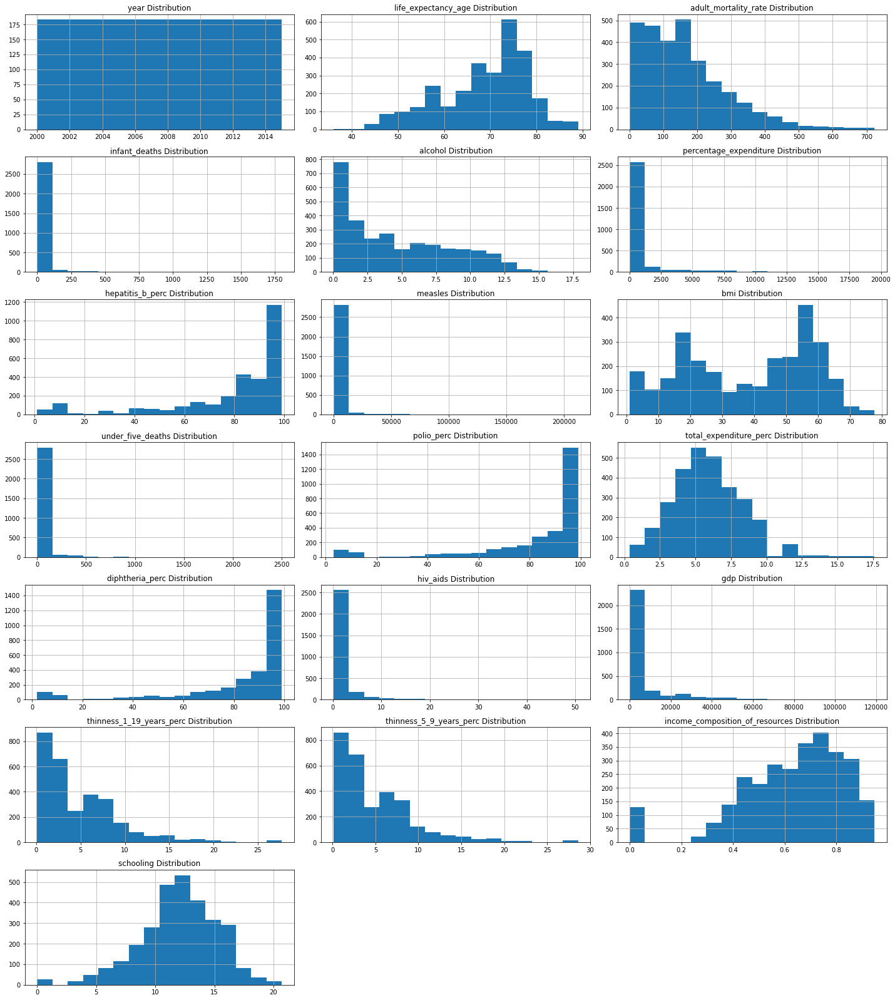

In [34]:
# Univariate visualization without having to manually plot each graph

def draw_histograms(df, columns, n_rows, n_cols):
    fig=plt.figure(figsize =(20, 60))
    for i, var_name in enumerate(columns):
        ax=fig.add_subplot(n_rows,n_cols,i+1)
        df[var_name].hist(bins=16,ax=ax)
        ax.set_title(var_name + " Distribution")
        
    fig.tight_layout()  # Improves appearance a bit.
    plt.show()
    
draw_histograms(df_life_expectancy_5, numeric_list, len(numeric_list), 3)

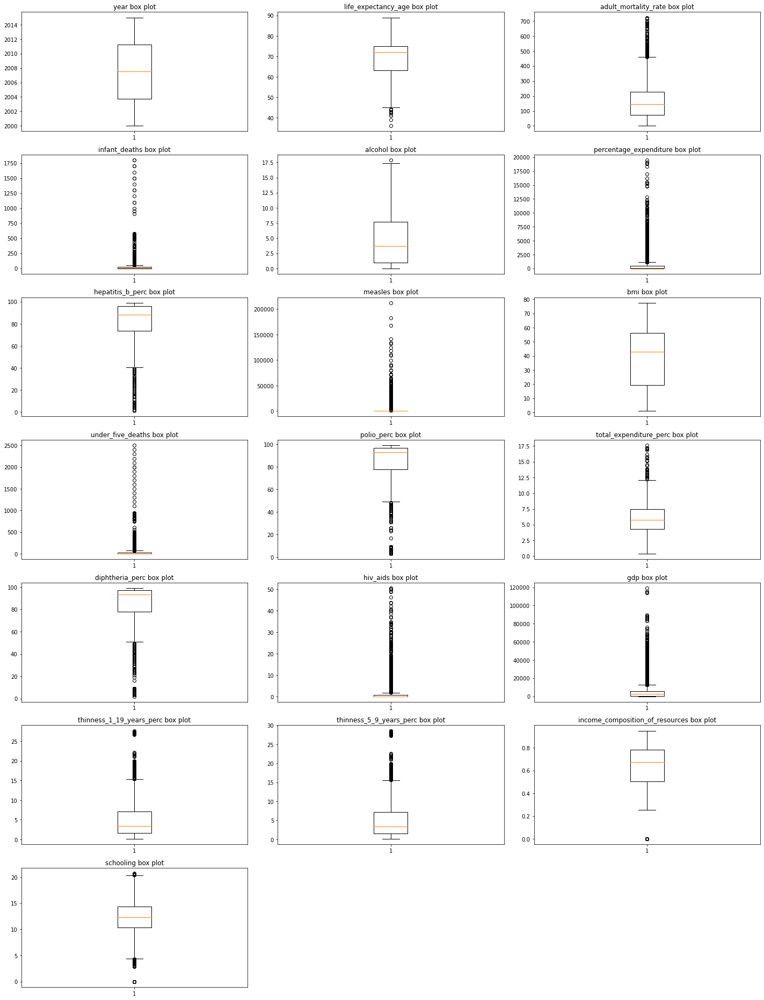

In [35]:
# box plots of to viualize outliers

def draw_box(df, columns, n_rows, n_cols):
    fig=plt.figure(figsize =(20, 70))
    for i, var_name in enumerate(columns):
        ax=fig.add_subplot(n_rows,n_cols,i+1)
        ax.boxplot(df[var_name])
        ax.set_title(var_name + ' box plot')
    fig.tight_layout()
    plt.show()
    
draw_box(df_life_expectancy_5, numeric_list, len(numeric_list), 3)

In [36]:
# Calculate number of outliers and its percentage in each variable using Tukey's method.

for variable in numeric_list:
    q75, q25 = np.percentile(df_life_expectancy_5[variable], [75 ,25])
    iqr = q75 - q25

    min_val = q25 - (iqr*1.5)
    max_val = q75 + (iqr*1.5)
    print("Number of outliers and percentage of it in {} : {} and {}".format(variable,
                                                                             len((np.where((df_life_expectancy_5[variable] > max_val) | 
                                                                                           (df_life_expectancy_5[variable] < min_val))[0])),len((np.where((df_life_expectancy_5[variable] > max_val) | 
                                                                                           (df_life_expectancy_5[variable] < min_val))[0]))*100/1987))

Number of outliers and percentage of it in year : 0 and 0.0
Number of outliers and percentage of it in life_expectancy_age : 19 and 0.9562154001006542
Number of outliers and percentage of it in adult_mortality_rate : 82 and 4.12682435832914
Number of outliers and percentage of it in infant_deaths : 315 and 15.853044791142425
Number of outliers and percentage of it in alcohol : 1 and 0.050327126321087066
Number of outliers and percentage of it in percentage_expenditure : 388 and 19.52692501258178
Number of outliers and percentage of it in hepatitis_b_perc : 260 and 13.085052843482638
Number of outliers and percentage of it in measles : 542 and 27.27730246602919
Number of outliers and percentage of it in bmi : 0 and 0.0
Number of outliers and percentage of it in under_five_deaths : 394 and 19.828887770508302
Number of outliers and percentage of it in polio_perc : 278 and 13.990941117262205
Number of outliers and percentage of it in total_expenditure_perc : 34 and 1.7111222949169602
Numbe

In [37]:
# create new dataframe to review zscores. This new dataframe will not be used in further analysis.
df_life_zscore = df_life_expectancy_5.copy()

In [38]:
# find zscores for all float columns, add zscore columns to existing dataframe
for col in numeric_list:
    col_zscore = col + '_zscore' # adding columns to the dataframe that result in column name + '_zscore'
    df_life_zscore[col_zscore] = (df_life_zscore[col] - df_life_zscore[col].mean())/df_life_zscore[col].std(ddof=0)
df_life_zscore.head()

,country,year,status,life_expectancy_age,adult_mortality_rate,infant_deaths,alcohol,percentage_expenditure,hepatitis_b_perc,measles,bmi,under_five_deaths,polio_perc,total_expenditure_perc,diphtheria_perc,hiv_aids,gdp,thinness_1_19_years_perc,thinness_5_9_years_perc,income_composition_of_resources,schooling,year_zscore,life_expectancy_age_zscore,adult_mortality_rate_zscore,infant_deaths_zscore,alcohol_zscore,percentage_expenditure_zscore,hepatitis_b_perc_zscore,measles_zscore,bmi_zscore,under_five_deaths_zscore,polio_perc_zscore,total_expenditure_perc_zscore,diphtheria_perc_zscore,hiv_aids_zscore,gdp_zscore,thinness_1_19_years_perc_zscore,thinness_5_9_years_perc_zscore,income_composition_of_resources_zscore,schooling_zscore
0,Afghanistan,2015,Developing,65,263.00,62.00,0.01,71.28,65.00,1154.00,19.10,83.00,6.00,8.16,65.00,0.10,584.26,17.20,17.30,0.48,10.10,1.63,-0.40,0.79,0.27,-1.14,-0.34,-0.57,-0.11,-0.96,0.25,-3.26,0.92,-0.72,-0.32,-0.50,2.81,2.77,-0.72,-0.58
1,Afghanistan,2014,Developing,59,271.00,64.00,0.01,73.52,62.00,492.00,18.60,86.00,58.00,8.18,62.00,0.10,612.70,17.50,17.50,0.48,10.00,1.41,-1.03,0.85,0.28,-1.14,-0.33,-0.69,-0.17,-0.99,0.27,-1.04,0.93,-0.85,-0.32,-0.49,2.87,2.81,-0.74,-0.61
2,Afghanistan,2013,Developing,59,268.00,66.00,0.01,73.22,64.00,430.00,18.10,89.00,62.00,8.13,64.00,0.10,631.74,17.70,17.70,0.47,9.90,1.19,-1.03,0.83,0.30,-1.14,-0.34,-0.61,-0.17,-1.01,0.29,-0.87,0.91,-0.77,-0.32,-0.49,2.92,2.86,-0.77,-0.64
3,Afghanistan,2012,Developing,59,272.00,69.00,0.01,78.18,67.00,2787.00,17.60,93.00,67.00,8.52,67.00,0.10,669.96,17.90,18.00,0.46,9.80,0.98,-1.03,0.86,0.33,-1.14,-0.33,-0.49,0.03,-1.04,0.32,-0.66,1.07,-0.64,-0.32,-0.49,2.97,2.92,-0.80,-0.68
4,Afghanistan,2011,Developing,59,275.00,71.00,0.01,7.10,68.00,3013.00,17.20,97.00,68.00,7.87,68.00,0.10,63.54,18.20,18.20,0.45,9.50,0.76,-1.03,0.89,0.34,-1.14,-0.37,-0.45,0.05,-1.06,0.34,-0.61,0.80,-0.60,-0.32,-0.53,3.03,2.97,-0.84,-0.77


In [39]:
# new dataframe with only zscores
zscore_df_filtered = df_life_zscore.filter(regex='zscore$', axis=1)
zscore_df_filtered.head()

,year_zscore,life_expectancy_age_zscore,adult_mortality_rate_zscore,infant_deaths_zscore,alcohol_zscore,percentage_expenditure_zscore,hepatitis_b_perc_zscore,measles_zscore,bmi_zscore,under_five_deaths_zscore,polio_perc_zscore,total_expenditure_perc_zscore,diphtheria_perc_zscore,hiv_aids_zscore,gdp_zscore,thinness_1_19_years_perc_zscore,thinness_5_9_years_perc_zscore,income_composition_of_resources_zscore,schooling_zscore
0,1.63,-0.40,0.79,0.27,-1.14,-0.34,-0.57,-0.11,-0.96,0.25,-3.26,0.92,-0.72,-0.32,-0.50,2.81,2.77,-0.72,-0.58
1,1.41,-1.03,0.85,0.28,-1.14,-0.33,-0.69,-0.17,-0.99,0.27,-1.04,0.93,-0.85,-0.32,-0.49,2.87,2.81,-0.74,-0.61
2,1.19,-1.03,0.83,0.30,-1.14,-0.34,-0.61,-0.17,-1.01,0.29,-0.87,0.91,-0.77,-0.32,-0.49,2.92,2.86,-0.77,-0.64
3,0.98,-1.03,0.86,0.33,-1.14,-0.33,-0.49,0.03,-1.04,0.32,-0.66,1.07,-0.64,-0.32,-0.49,2.97,2.92,-0.80,-0.68
4,0.76,-1.03,0.89,0.34,-1.14,-0.37,-0.45,0.05,-1.06,0.34,-0.61,0.80,-0.60,-0.32,-0.53,3.03,2.97,-0.84,-0.77


In [40]:
# box plots of all float data for df_life_expectancy_5
# this function with a for loop iterates throughout the dataframe by a given list to provide outlier information
# the df2 isn't 100% necessary, but it's a cleaner output for summary, and it's a good cross check based on the 2 methods to
#     make sure they both line up... Hint: they do.

def find_outliers(df, columns, df2):
    z_scores = zscore(df[columns])
    for threshold in range(1,5):
        print("The score threshold is: {}".format(threshold))
        print(z_scores[z_scores > threshold]) 
        print(((df2[df2 > threshold])).count().sort_values(ascending = False)) # provides organized sum of outliers by column
        print("The score threshold is: {}".format(threshold))
        print("The indices of the outliers:")
        print(np.where(z_scores > threshold))
        print("Number of outliers is: {}".format(len((np.where(z_scores > threshold)[0]))))
        outlier_cols = df2.columns    
    print("The outlier columns are: {}".format(outlier_cols))
         

    
find_outliers(df_life_expectancy_5, numeric_list, zscore_df_filtered)

The score threshold is: 1
[1.62697843 2.80637002 2.76650558 ... 8.2113994  1.39628274 1.40647388]
alcohol_zscore                            593
year_zscore                               549
bmi_zscore                                536
schooling_zscore                          473
total_expenditure_perc_zscore             466
income_composition_of_resources_zscore    436
adult_mortality_rate_zscore               401
life_expectancy_age_zscore                377
thinness_1_19_years_perc_zscore           354
thinness_5_9_years_perc_zscore            350
gdp_zscore                                346
percentage_expenditure_zscore             222
hiv_aids_zscore                           187
measles_zscore                            112
infant_deaths_zscore                      110
under_five_deaths_zscore                  104
diphtheria_perc_zscore                      0
polio_perc_zscore                           0
hepatitis_b_perc_zscore                     0
dtype: int64
The score thres

I originally created for loops to winsorize groups of data. However, the bulk approach was statistically inaccurate and I haven't seen any examples of how to approach this without creating unique, winsorizing code for each variable.

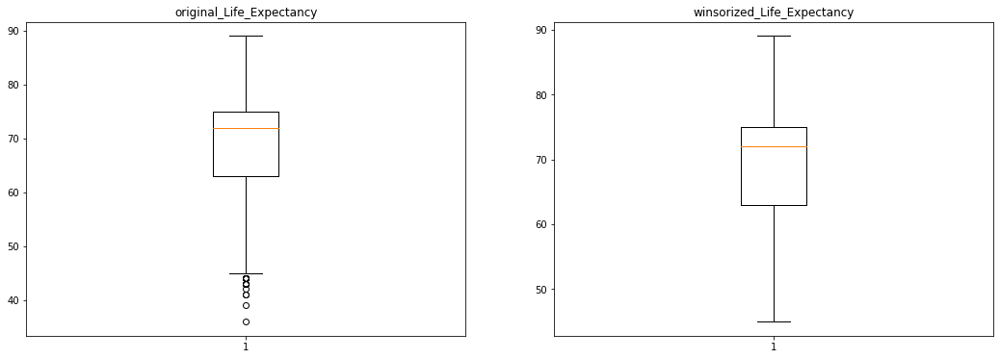

In [43]:
# Removing Outliers in the variables using Winsorization technique.
#Winsorize Life_Expectancy
plt.figure(figsize=(18,6))

plt.subplot(1,2,1)
original_Life_Expectancy = df_life_expectancy_5['life_expectancy_age']
plt.boxplot(original_Life_Expectancy)
plt.title("original_Life_Expectancy")

plt.subplot(1,2,2)
df_life_expectancy_5['winsorized_life_expectancy'] = winsorize(df_life_expectancy_5['life_expectancy_age'], (0.01, 0))
winsorized_Life_Expectancy = df_life_expectancy_5['winsorized_life_expectancy']
plt.boxplot(df_life_expectancy_5['winsorized_life_expectancy'])
plt.title("winsorized_Life_Expectancy")

plt.show()

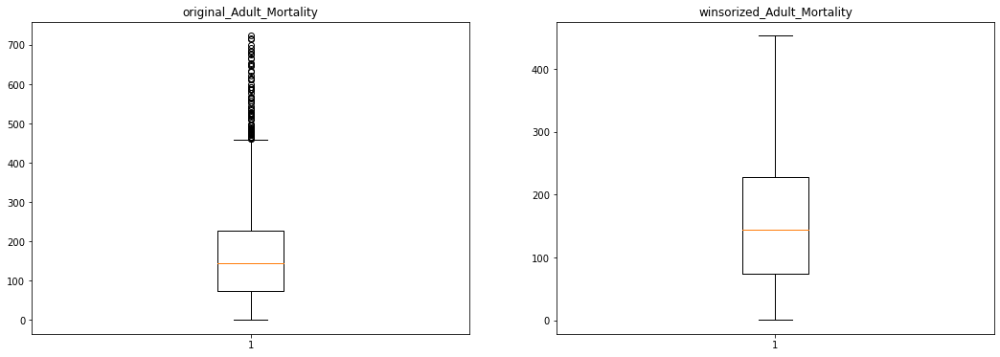

In [44]:
# Winsorize Adult_Mortality
plt.figure(figsize=(18,6))

plt.subplot(1,2,1)
original_Adult_Mortality = df_life_expectancy_5['adult_mortality_rate']
plt.boxplot(original_Adult_Mortality)
plt.title("original_Adult_Mortality")

plt.subplot(1,2,2)
df_life_expectancy_5['winsorized_adult_mortality'] = winsorize(df_life_expectancy_5['adult_mortality_rate'], (0, 0.03))
winsorized_Adult_Mortality = df_life_expectancy_5['winsorized_adult_mortality']
plt.boxplot(winsorized_Adult_Mortality)
plt.title("winsorized_Adult_Mortality")

plt.show()

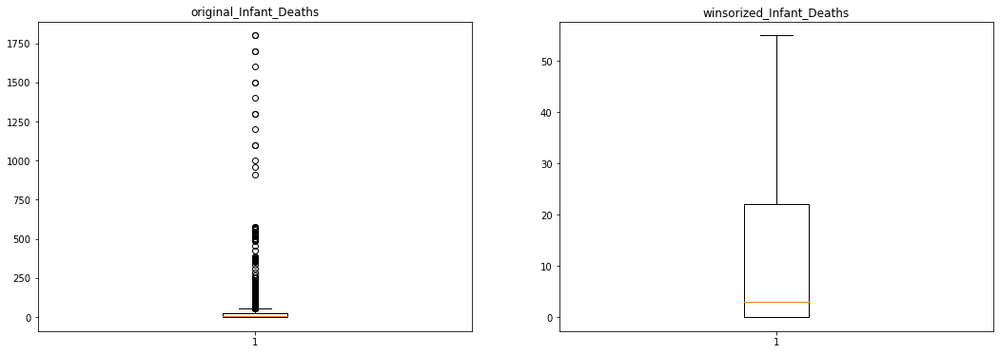

In [45]:
# Winsorize Infant_Deaths
plt.figure(figsize=(18,6))

plt.subplot(1,2,1)
original_Infant_Deaths = df_life_expectancy_5['infant_deaths']
plt.boxplot(original_Infant_Deaths)
plt.title("original_Infant_Deaths")

plt.subplot(1,2,2)
df_life_expectancy_5['winsorized_infant_deaths'] = winsorize(df_life_expectancy_5['infant_deaths'], (0, 0.11))
winsorized_Infant_Deaths = df_life_expectancy_5['winsorized_infant_deaths']
plt.boxplot(winsorized_Infant_Deaths)
plt.title("winsorized_Infant_Deaths")

plt.show()

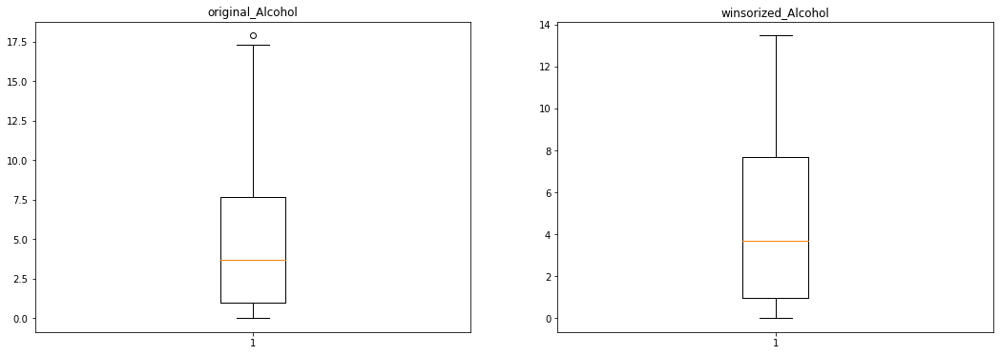

In [46]:
# Winsorize Alcohol
plt.figure(figsize=(18,6))

plt.subplot(1,2,1)
original_Alcohol = df_life_expectancy_5['alcohol']
plt.boxplot(original_Alcohol)
plt.title("original_Alcohol")

plt.subplot(1,2,2)
df_life_expectancy_5['winsorized_alcohol'] = winsorize(df_life_expectancy_5['alcohol'], (0, 0.01))
winsorized_Alcohol = df_life_expectancy_5['winsorized_alcohol']
plt.boxplot(winsorized_Alcohol)
plt.title("winsorized_Alcohol")

plt.show()

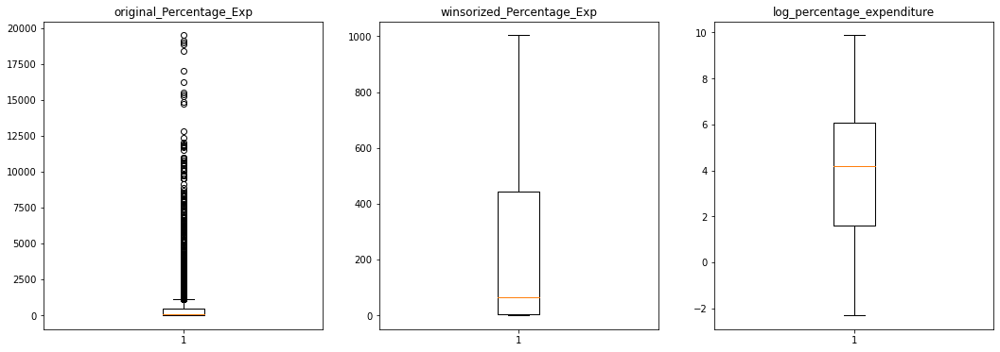

In [47]:
# Winsorize Percentage_Exp
plt.figure(figsize=(18,6))

plt.subplot(1,3,1)
original_Percentage_Exp = df_life_expectancy_5['percentage_expenditure']
plt.boxplot(original_Percentage_Exp)
plt.title("original_Percentage_Exp")

plt.subplot(1,3,2)
df_life_expectancy_5['winsorized_perc_exp'] = winsorize(df_life_expectancy_5['percentage_expenditure'], (0, 0.14))
winsorized_Percentage_Exp = df_life_expectancy_5['winsorized_perc_exp']
plt.boxplot(winsorized_Percentage_Exp)
plt.title("winsorized_Percentage_Exp")

plt.subplot(1,3,3)
df_life_expectancy_5['log_perc_exp'] = np.log(df_life_expectancy_5['percentage_expenditure'])
log_perc_exp = df_life_expectancy_5['log_perc_exp']
plt.boxplot(log_perc_exp)
plt.title("log_percentage_expenditure")


plt.show()

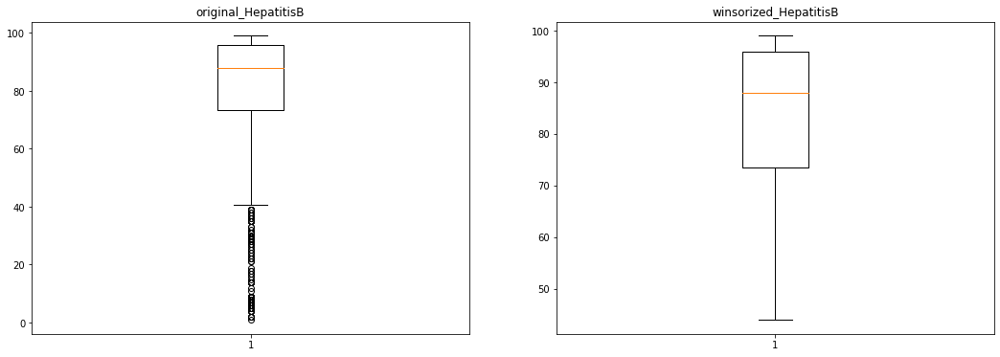

In [48]:
# Winsorize HepatitisB
plt.figure(figsize=(18,6))

plt.subplot(1,2,1)
original_HepatitisB = df_life_expectancy_5['hepatitis_b_perc']
plt.boxplot(original_HepatitisB)
plt.title("original_HepatitisB")

plt.subplot(1,2,2)
df_life_expectancy_5['winsorized_hep_b'] = winsorize(df_life_expectancy_5['hepatitis_b_perc'], (0.11, 0))
winsorized_HepatitisB = df_life_expectancy_5['winsorized_hep_b']
plt.boxplot(winsorized_HepatitisB)
plt.title("winsorized_HepatitisB")

plt.show()

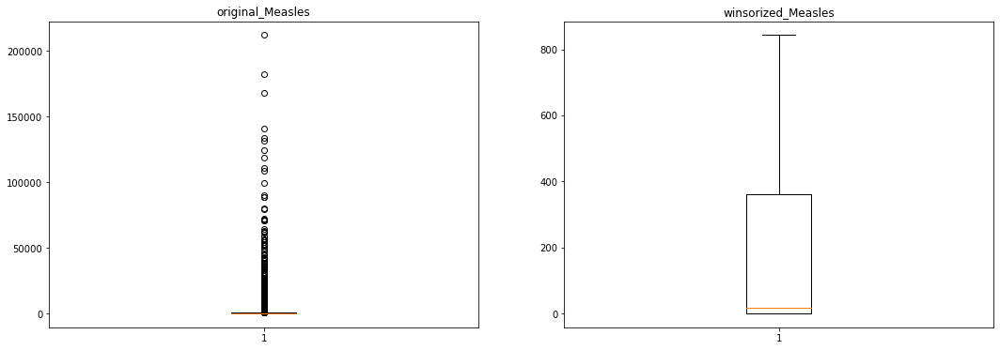

In [49]:
# Winsorize Measles
plt.figure(figsize=(18,6))

plt.subplot(1,2,1)
original_Measles = df_life_expectancy_5['measles']
plt.boxplot(original_Measles)
plt.title("original_Measles")

plt.subplot(1,2,2)
df_life_expectancy_5['winsorized_measles'] = winsorize(df_life_expectancy_5['measles'], (0, 0.19))
winsorized_Measles = df_life_expectancy_5['winsorized_measles']
plt.boxplot(winsorized_Measles)
plt.title("winsorized_Measles")

plt.show()

Winsorization changes 19% of the data. Be careful.

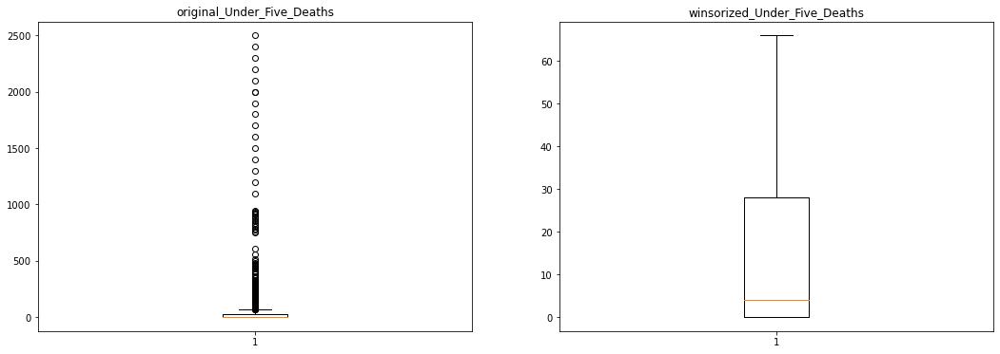

In [50]:
# Winsorize Under_Five_Deaths
plt.figure(figsize=(18,6))

plt.subplot(1,2,1)
original_Under_Five_Deaths = df_life_expectancy_5['under_five_deaths']
plt.boxplot(original_Under_Five_Deaths)
plt.title("original_Under_Five_Deaths")

plt.subplot(1,2,2)
df_life_expectancy_5['winsorized_under_five_deaths'] = winsorize(df_life_expectancy_5['under_five_deaths'], (0, 0.14))
winsorized_Under_Five_Deaths = df_life_expectancy_5['winsorized_under_five_deaths']
plt.boxplot(winsorized_Under_Five_Deaths)
plt.title("winsorized_Under_Five_Deaths")

plt.show()

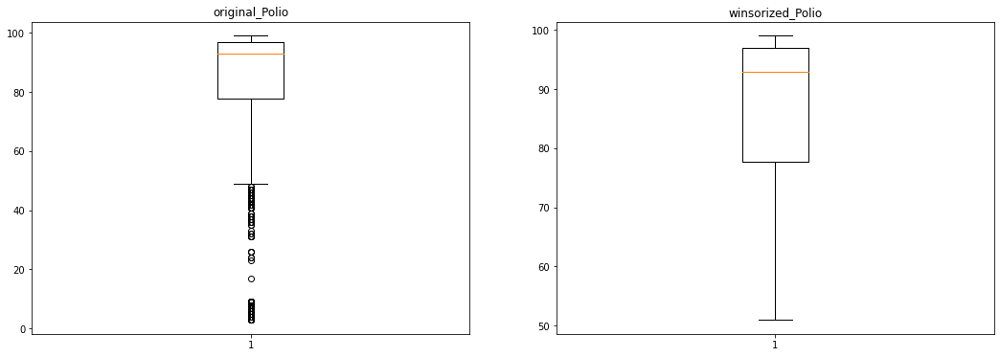

In [51]:
# Winsorize Polio
plt.figure(figsize=(18,6))

plt.subplot(1,2,1)
original_Polio = df_life_expectancy_5['polio_perc']
plt.boxplot(original_Polio)
plt.title("original_Polio")

plt.subplot(1,2,2)
df_life_expectancy_5['winsorized_polio'] = winsorize(df_life_expectancy_5['polio_perc'], (0.10, 0))
winsorized_Polio = df_life_expectancy_5['winsorized_polio']
plt.boxplot(winsorized_Polio)
plt.title("winsorized_Polio")

plt.show()

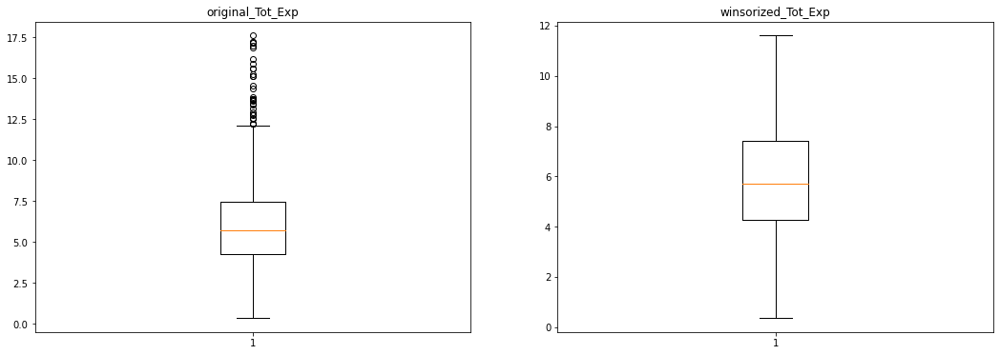

In [52]:
# Winsorize Tot_Exp
plt.figure(figsize=(18,6))

plt.subplot(1,2,1)
original_Tot_Exp = df_life_expectancy_5['total_expenditure_perc']
plt.boxplot(original_Tot_Exp)
plt.title("original_Tot_Exp")

plt.subplot(1,2,2)
df_life_expectancy_5['winsorized_tot_exp'] = winsorize(df_life_expectancy_5['total_expenditure_perc'], (0, 0.02))
winsorized_Tot_Exp = df_life_expectancy_5['winsorized_tot_exp']
plt.boxplot(winsorized_Tot_Exp)
plt.title("winsorized_Tot_Exp")

plt.show()

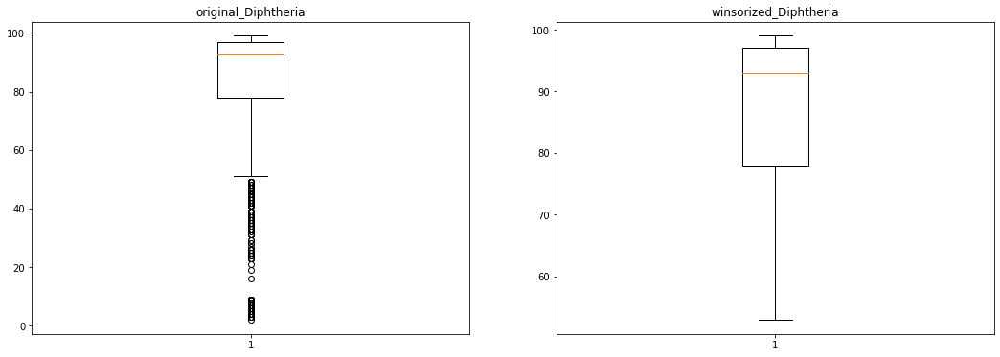

In [53]:
# Winsorize Diphtheria
plt.figure(figsize=(18,6))

plt.subplot(1,2,1)
original_Diphtheria = df_life_expectancy_5['diphtheria_perc']
plt.boxplot(original_Diphtheria)
plt.title("original_Diphtheria")

plt.subplot(1,2,2)
df_life_expectancy_5['winsorized_diphtheria'] = winsorize(df_life_expectancy_5['diphtheria_perc'], (0.11, 0))
winsorized_Diphtheria = df_life_expectancy_5['winsorized_diphtheria']
plt.boxplot(winsorized_Diphtheria)
plt.title("winsorized_Diphtheria")

plt.show()

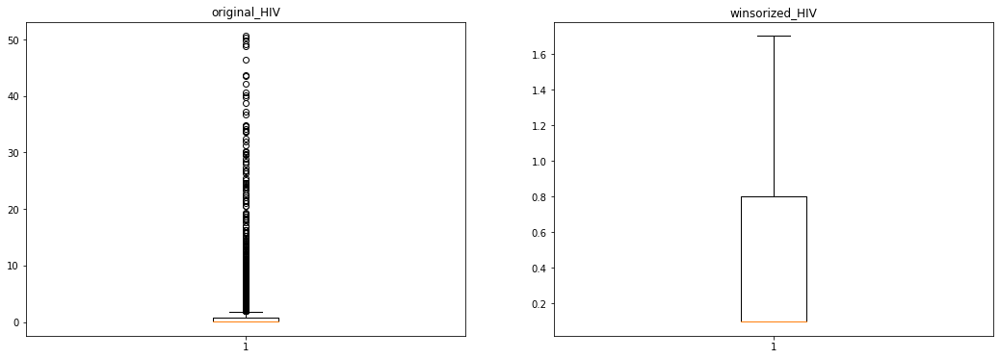

In [54]:
# Winsorize HIV/AIDS
plt.figure(figsize=(18,6))

plt.subplot(1,2,1)
original_HIV = df_life_expectancy_5['hiv_aids']
plt.boxplot(original_HIV)
plt.title("original_HIV")

plt.subplot(1,2,2)
df_life_expectancy_5['winsorized_hiv_aids'] = winsorize(df_life_expectancy_5['hiv_aids'], (0, 0.19))
winsorized_HIV = df_life_expectancy_5['winsorized_hiv_aids']
plt.boxplot(winsorized_HIV)
plt.title("winsorized_HIV")

plt.show()

Winsorization changes 19% of the data. Be careful.

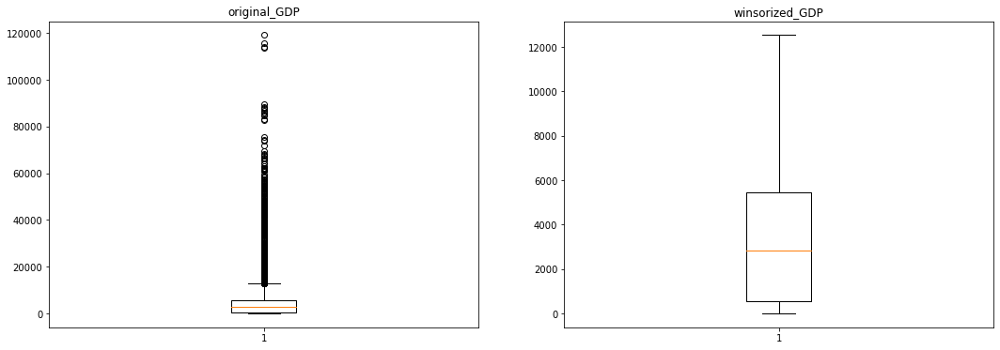

In [55]:
# Winsorize GDP
plt.figure(figsize=(18,6))

plt.subplot(1,2,1)
original_GDP = df_life_expectancy_5['gdp']
plt.boxplot(original_GDP)
plt.title("original_GDP")

plt.subplot(1,2,2)
df_life_expectancy_5['winsorized_gdp'] = winsorize(df_life_expectancy_5['gdp'], (0,0.16))
winsorized_GDP = df_life_expectancy_5['winsorized_gdp']
plt.boxplot(winsorized_GDP)
plt.title("winsorized_GDP")

plt.show()

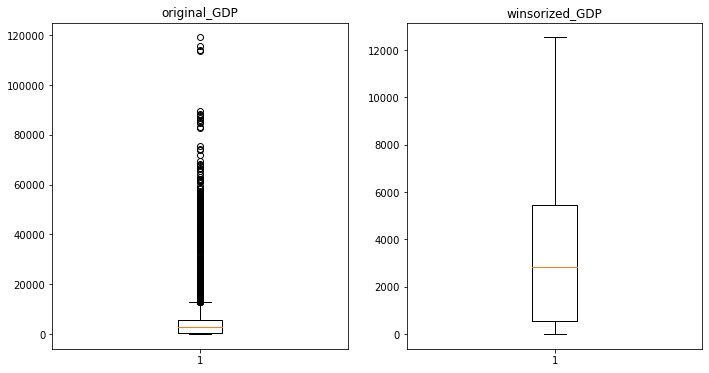

In [56]:
# Winsorize GDP
plt.figure(figsize=(18,6))

plt.subplot(1,3,1)
original_GDP = df_life_expectancy_5['gdp']
plt.boxplot(original_GDP)
plt.title("original_GDP")

plt.subplot(1,3,2)
df_life_expectancy_5['winsorized_gdp'] = winsorize(df_life_expectancy_5['gdp'], (0,0.16))
winsorized_GDP = df_life_expectancy_5['winsorized_gdp']
plt.boxplot(winsorized_GDP)
plt.title("winsorized_GDP")

plt.show()

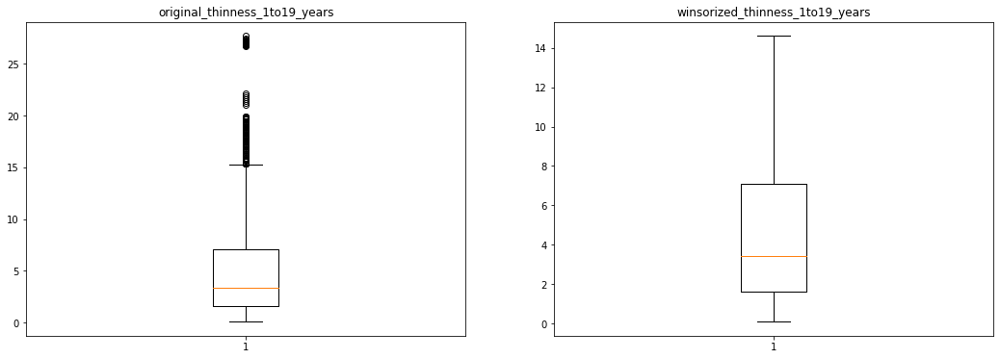

In [57]:
# Winsorize thinness_1to19_years
plt.figure(figsize=(18,6))

plt.subplot(1,2,1)
original_thinness_1to19_years = df_life_expectancy_5['thinness_1_19_years_perc']
plt.boxplot(original_thinness_1to19_years)
plt.title("original_thinness_1to19_years")

plt.subplot(1,2,2)
df_life_expectancy_5['winsorized_thinness_1_19'] = winsorize(df_life_expectancy_5['thinness_1_19_years_perc'], (0, 0.04))
winsorized_thinness_1to19_years = df_life_expectancy_5['winsorized_thinness_1_19']
plt.boxplot(winsorized_thinness_1to19_years)
plt.title("winsorized_thinness_1to19_years")

plt.show()

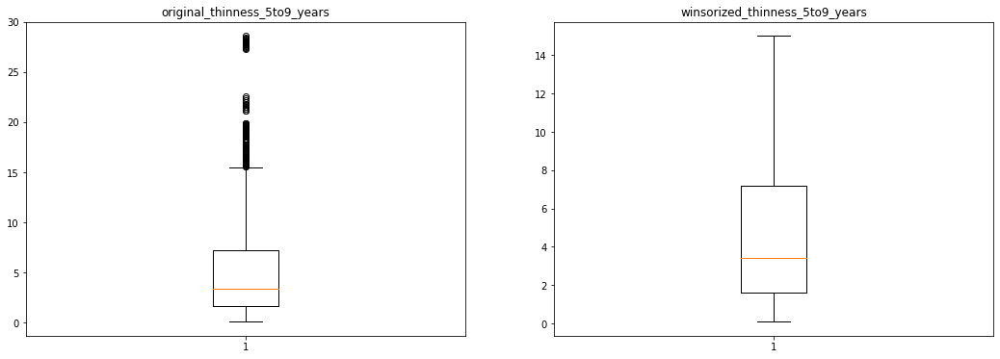

In [58]:
# Winsorize thinness_5to9_years
plt.figure(figsize=(18,6))

plt.subplot(1,2,1)
original_thinness_5to9_years = df_life_expectancy_5['thinness_5_9_years_perc']
plt.boxplot(original_thinness_5to9_years)
plt.title("original_thinness_5to9_years")

plt.subplot(1,2,2)
df_life_expectancy_5['winsorized_thinness_5_9'] = winsorize(df_life_expectancy_5['thinness_5_9_years_perc'], (0, 0.04))
winsorized_thinness_5to9_years = df_life_expectancy_5['winsorized_thinness_5_9']
plt.boxplot(winsorized_thinness_5to9_years)
plt.title("winsorized_thinness_5to9_years")

plt.show()

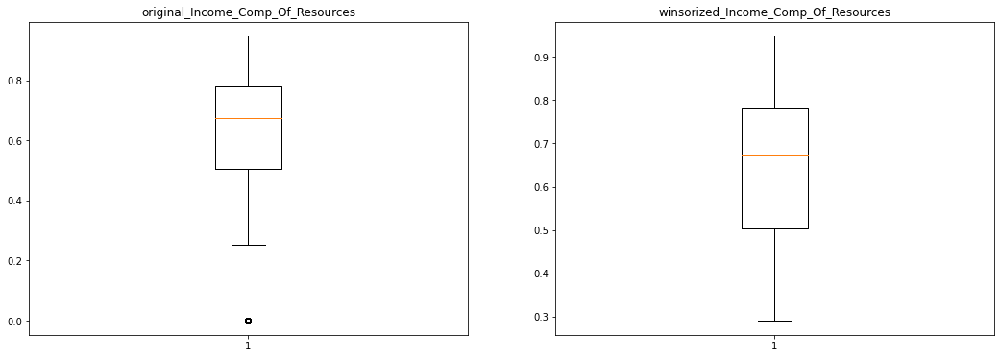

In [59]:
# Winsorize Income_Comp_Of_Resources
plt.figure(figsize=(18,6))

plt.subplot(1,2,1)
original_Income_Comp_Of_Resources = df_life_expectancy_5['income_composition_of_resources']
plt.boxplot(original_Income_Comp_Of_Resources)
plt.title("original_Income_Comp_Of_Resources")

plt.subplot(1,2,2)
df_life_expectancy_5['winsorized_income_composition_of_res'] = winsorize(df_life_expectancy_5['income_composition_of_resources'], (0.05, 0))
winsorized_Income_Comp_Of_Resources = df_life_expectancy_5['winsorized_income_composition_of_res']
plt.boxplot(winsorized_Income_Comp_Of_Resources)
plt.title("winsorized_Income_Comp_Of_Resources")

plt.show()

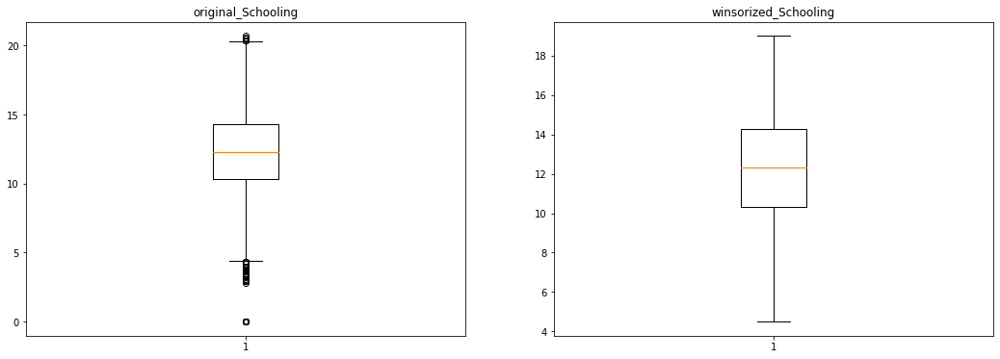

In [60]:
# Winsorize Schooling
plt.figure(figsize=(18,6))

plt.subplot(1,2,1)
original_Schooling = df_life_expectancy_5['schooling']
plt.boxplot(original_Schooling)
plt.title("original_Schooling")

plt.subplot(1,2,2)
df_life_expectancy_5['winsorized_schooling'] = winsorize(df_life_expectancy_5['schooling'], (0.02, 0.01))
winsorized_Schooling = df_life_expectancy_5['winsorized_schooling']
plt.boxplot(winsorized_Schooling)
plt.title("winsorized_Schooling")

plt.show()

In [62]:
# Check number of Outliers after Winsorization for each variable.

# list of only winsorized columns
win_list = [col for col in df_life_expectancy_5 if col.startswith('winsorized')]
    
# Calculate number of outliers and its percentage in each variable using Tukey's method.

for variable in win_list:
    q75, q25 = np.percentile(df_life_expectancy_5[variable], [75 ,25])
    iqr = q75 - q25

    min_val = q25 - (iqr*1.5)
    max_val = q75 + (iqr*1.5)
    print("Number of outliers and percentage of it in {} : {} and {}".format(variable,
                                                                             len((np.where((df_life_expectancy_5[variable] > max_val) | 
                                                                                           (df_life_expectancy_5[variable] < min_val))[0])),len((np.where((df_life_expectancy_5[variable] > max_val) | 
                                                                                           (df_life_expectancy_5[variable] < min_val))[0]))*100/1987))

Number of outliers and percentage of it in winsorized_life_expectancy : 0 and 0.0
Number of outliers and percentage of it in winsorized_adult_mortality : 0 and 0.0
Number of outliers and percentage of it in winsorized_infant_deaths : 0 and 0.0
Number of outliers and percentage of it in winsorized_alcohol : 0 and 0.0
Number of outliers and percentage of it in winsorized_perc_exp : 0 and 0.0
Number of outliers and percentage of it in winsorized_hep_b : 0 and 0.0
Number of outliers and percentage of it in winsorized_measles : 0 and 0.0
Number of outliers and percentage of it in winsorized_under_five_deaths : 0 and 0.0
Number of outliers and percentage of it in winsorized_polio : 0 and 0.0
Number of outliers and percentage of it in winsorized_tot_exp : 0 and 0.0
Number of outliers and percentage of it in winsorized_diphtheria : 0 and 0.0
Number of outliers and percentage of it in winsorized_hiv_aids : 0 and 0.0
Number of outliers and percentage of it in winsorized_gdp : 0 and 0.0
Number of

### Moving on to exploratory analysis

In [63]:
df_life_expectancy_5.describe()

,year,life_expectancy_age,adult_mortality_rate,infant_deaths,alcohol,percentage_expenditure,hepatitis_b_perc,measles,bmi,under_five_deaths,polio_perc,total_expenditure_perc,diphtheria_perc,hiv_aids,gdp,thinness_1_19_years_perc,thinness_5_9_years_perc,income_composition_of_resources,schooling,winsorized_life_expectancy,winsorized_adult_mortality,winsorized_infant_deaths,winsorized_alcohol,winsorized_perc_exp,log_perc_exp,winsorized_hep_b,winsorized_measles,winsorized_under_five_deaths,winsorized_polio,winsorized_tot_exp,winsorized_diphtheria,winsorized_hiv_aids,winsorized_gdp,winsorized_thinness_1_19,winsorized_thinness_5_9,winsorized_income_composition_of_res,winsorized_schooling
count,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00,2928.00
mean,2007.50,68.82,164.80,30.41,4.61,740.32,78.92,2427.86,38.20,42.18,82.39,5.91,82.18,1.75,7246.68,4.86,4.89,0.63,12.03,68.84,161.91,13.68,4.59,271.78,-inf,81.57,223.73,17.48,85.30,5.87,85.47,0.51,4062.67,4.70,4.72,0.64,12.07
std,4.61,9.55,124.29,118.11,4.03,1990.93,24.54,11485.97,19.85,160.70,23.46,2.44,23.73,5.09,13437.25,4.40,4.49,0.21,3.30,9.51,115.42,19.12,3.99,363.52,nan,17.98,333.73,24.09,15.63,2.33,15.12,0.64,4352.62,3.86,3.92,0.17,3.14
min,2000.00,36.00,1.00,0.00,0.01,0.00,1.00,0.00,1.00,0.00,3.00,0.37,2.00,0.10,1.68,0.10,0.10,0.00,0.00,45.00,1.00,0.00,0.01,0.00,-inf,44.00,0.00,0.00,51.00,0.37,53.00,0.10,1.68,0.10,0.10,0.29,4.50
25%,2003.75,63.00,74.00,0.00,0.95,4.85,73.50,0.00,19.40,0.00,77.75,4.28,78.00,0.10,560.98,1.60,1.60,0.50,10.30,63.00,74.00,0.00,0.95,4.85,1.58,73.50,0.00,0.00,77.75,4.28,78.00,0.10,560.98,1.60,1.60,0.50,10.30
50%,2007.50,72.00,144.00,3.00,3.70,65.61,88.00,17.00,43.00,4.00,93.00,5.71,93.00,0.10,2832.34,3.40,3.40,0.67,12.30,72.00,144.00,3.00,3.70,65.61,4.18,88.00,17.00,4.00,93.00,5.71,93.00,0.10,2832.34,3.40,3.40,0.67,12.30
75%,2011.25,75.00,228.00,22.00,7.68,442.61,96.00,362.25,56.10,28.00,97.00,7.43,97.00,0.80,5453.28,7.10,7.20,0.78,14.30,75.00,228.00,22.00,7.68,442.61,6.09,96.00,362.25,28.00,97.00,7.43,97.00,0.80,5453.28,7.10,7.20,0.78,14.30
max,2015.00,89.00,723.00,1800.00,17.87,19479.91,99.00,212183.00,77.60,2500.00,99.00,17.60,99.00,50.60,119172.74,27.70,28.60,0.95,20.70,89.00,453.00,55.00,13.47,1003.37,9.88,99.00,843.00,66.00,99.00,11.60,99.00,1.70,12538.18,14.60,15.00,0.95,19.00


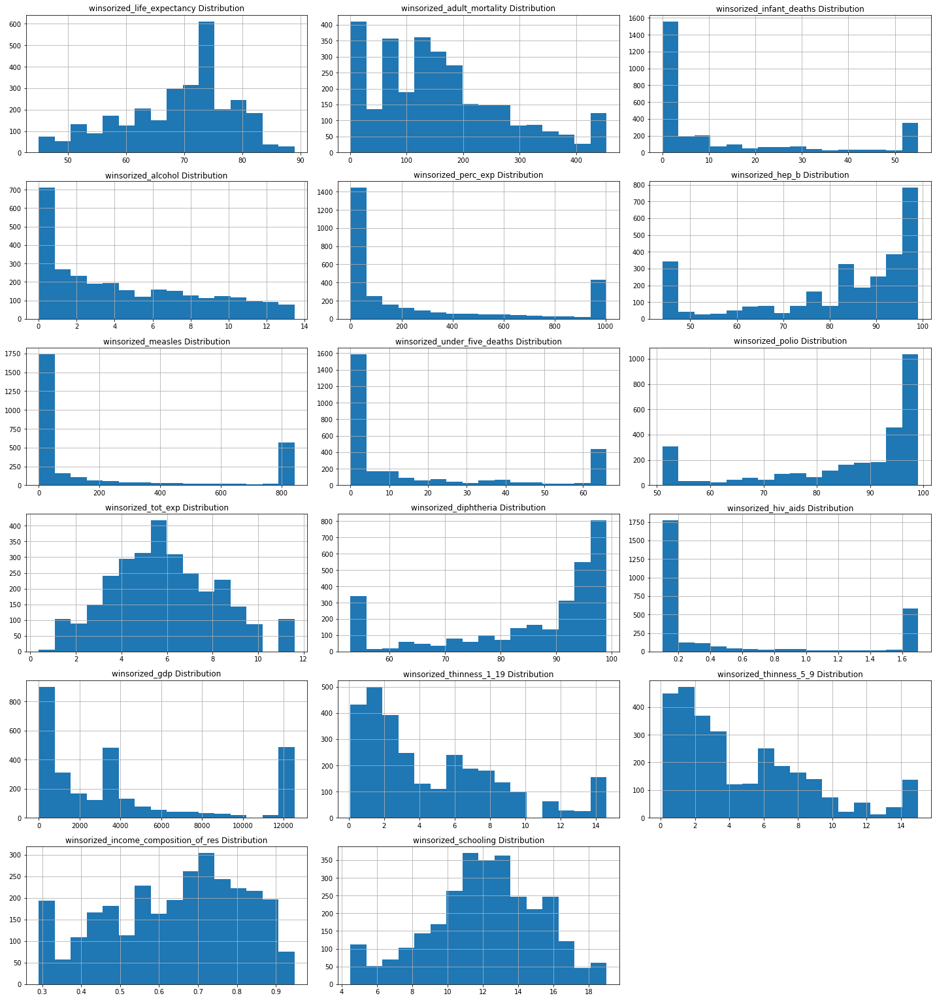

In [64]:
# Univariate visualization without having to manually plot each graph
# notice: the list of columns is referencing only the floats

def draw_histograms(df, columns, n_rows, n_cols):
    fig=plt.figure(figsize =(20, 60))
    for i, var_name in enumerate(columns):
        ax=fig.add_subplot(n_rows,n_cols,i+1)
        df[var_name].hist(bins=16,ax=ax)
        ax.set_title(var_name + " Distribution")
    fig.tight_layout()  # Improves appearance a bit.
    plt.show()
    
draw_histograms(df_life_expectancy_5, win_list, len(win_list), 3)

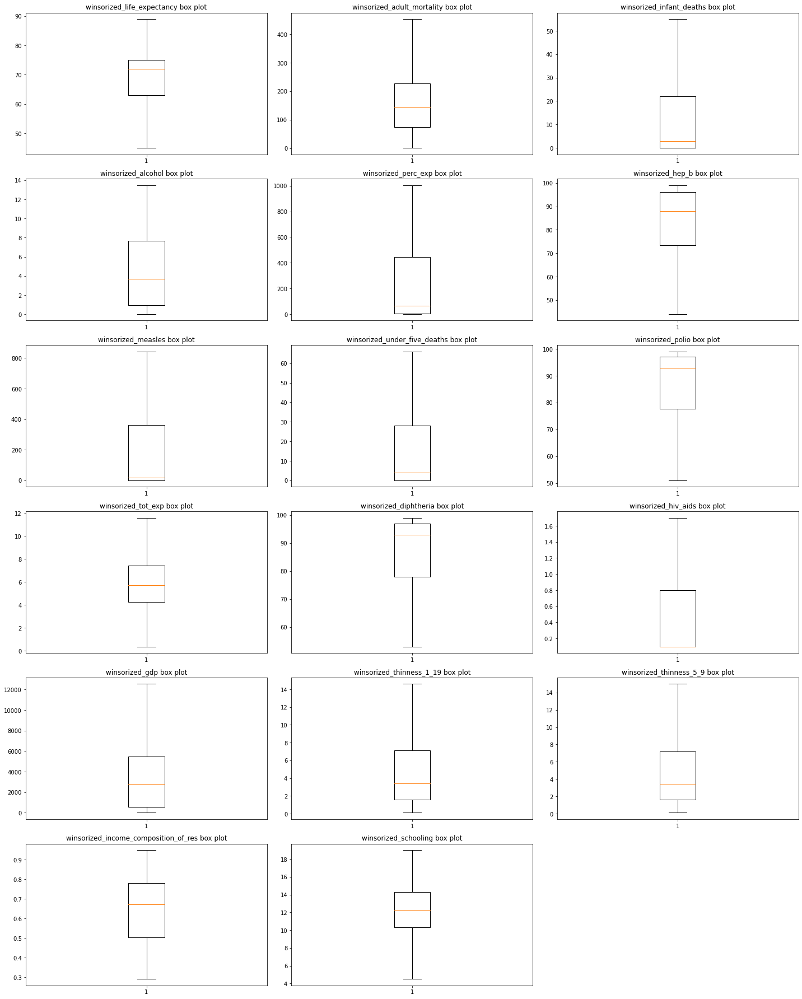

In [65]:
# box plots of all float data for df_life_expectancy_5 

def draw_box(df, columns, n_rows, n_cols):
    fig=plt.figure(figsize =(20, 70))
    for i, var_name in enumerate(columns):
        ax=fig.add_subplot(n_rows,n_cols,i+1)
        ax.boxplot(df[var_name])
        ax.set_title(var_name + ' box plot')
    fig.tight_layout()
    plt.show()
    
draw_box(df_life_expectancy_5, win_list, len(win_list), 3)


In [66]:
# Descriptive statistics of categorical variables.
df_life_expectancy_5.describe(include=['O'])

,country,status
count,2928,2928
unique,183,2
top,Indonesia,Developing
freq,16,2322


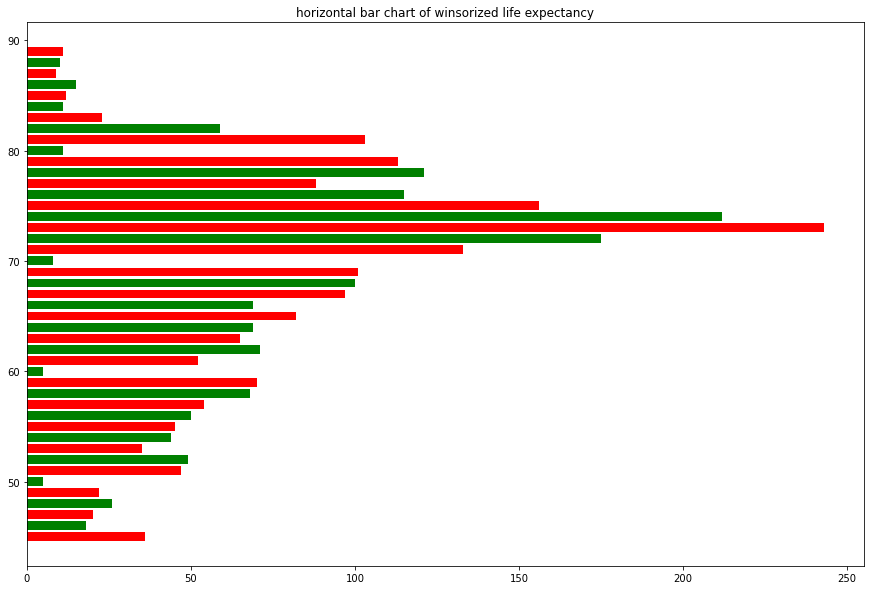

In [67]:
# bar chart of status
# notice: the majority of countries are classified as 'developing'
plt.figure(figsize=(15,10))
plt.barh(df_life_expectancy_5.groupby("winsorized_life_expectancy")["winsorized_life_expectancy"].count().index, 
        df_life_expectancy_5.groupby("winsorized_life_expectancy")["winsorized_life_expectancy"].count(), 
        color=["red","green"])
plt.title("horizontal bar chart of winsorized life expectancy")
plt.show()

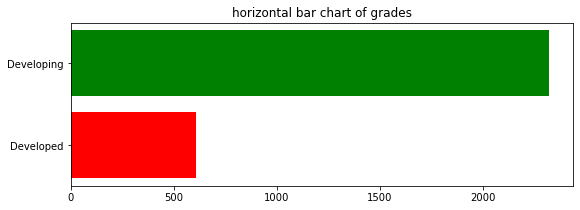

In [68]:
# bar chart of status
# notice: the majority of countries are classified as 'developing'
plt.figure(figsize=(9,3))
plt.barh(df_life_expectancy_5.groupby("status")["winsorized_life_expectancy"].count().index, 
        df_life_expectancy_5.groupby("status")["status"].count(), 
        color=["red","green"])
plt.title("horizontal bar chart of grades")
plt.show()

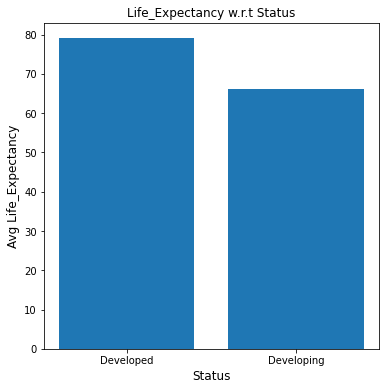

In [69]:
# Life_Expectancy w.r.t Status using bar plot.
plt.figure(figsize=(6,6))
plt.bar(df_life_expectancy_5.groupby('status')['status'].count().index,df_life_expectancy_5.groupby('status')['winsorized_life_expectancy'].mean())
plt.xlabel("Status",fontsize=12)
plt.ylabel("Avg Life_Expectancy",fontsize=12)
plt.title("Life_Expectancy w.r.t Status")
plt.show()


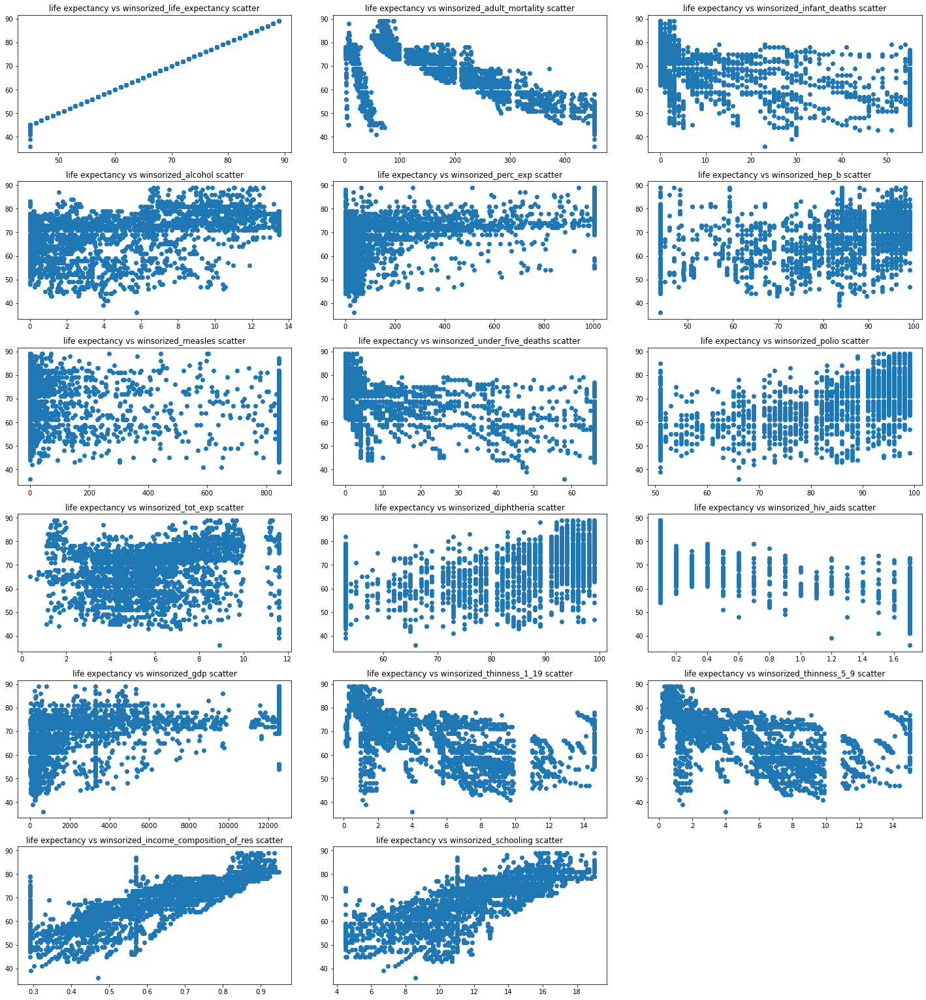

In [70]:
# Univariate visualization without having to manually plot each graph
# notice: the list of columns is referencing only the floats
#winsorized_df_list = new_winsorized_life.columns

def draw_scatters(df, columns, n_rows, n_cols):
    fig=plt.figure(figsize =(20, 60))
    for i, var_name in enumerate(columns):
        ax=fig.add_subplot(n_rows,n_cols,i+1)
        ax.scatter(df[var_name], df['life_expectancy_age'])
        ax.set_title('life expectancy vs ' + str(var_name) + " scatter")
    fig.tight_layout()  # Improves appearance a bit.
    plt.show()
    
draw_scatters(df_life_expectancy_5, win_list, len(win_list), 3)

Schooling and income composition appear to have a positive relationship with life expectancy.
Vaccination columns (polio, hep b, and diptheria) appear to have simliar positive relationships with life expectancy, but all seem fairly loose. <br>
Deaths under 5, adult mortality, and both thinness variables appear to have a negative relationship with life expectancy.

In [71]:
# create list of columns, keeping only winsorized columns
cols = [col for col in df_life_expectancy_5 if col.startswith('winsorized')]

In [72]:
# create new dataframe from column list
wins_df_le = df_life_expectancy_5[cols]

In [73]:
# add missing columns (year, status, country)
wins_df_le['year'] = df_life_expectancy_5['year']
wins_df_le['status'] = df_life_expectancy_5['status']
wins_df_le['country'] = df_life_expectancy_5['country']
wins_df_le.head()

,winsorized_life_expectancy,winsorized_adult_mortality,winsorized_infant_deaths,winsorized_alcohol,winsorized_perc_exp,winsorized_hep_b,winsorized_measles,winsorized_under_five_deaths,winsorized_polio,winsorized_tot_exp,winsorized_diphtheria,winsorized_hiv_aids,winsorized_gdp,winsorized_thinness_1_19,winsorized_thinness_5_9,winsorized_income_composition_of_res,winsorized_schooling,year,status,country
0,65,263.00,55.00,0.01,71.28,65.00,843.00,66.00,51.00,8.16,65.00,0.10,584.26,14.60,15.00,0.48,10.10,2015,Developing,Afghanistan
1,59,271.00,55.00,0.01,73.52,62.00,492.00,66.00,58.00,8.18,62.00,0.10,612.70,14.60,15.00,0.48,10.00,2014,Developing,Afghanistan
2,59,268.00,55.00,0.01,73.22,64.00,430.00,66.00,62.00,8.13,64.00,0.10,631.74,14.60,15.00,0.47,9.90,2013,Developing,Afghanistan
3,59,272.00,55.00,0.01,78.18,67.00,843.00,66.00,67.00,8.52,67.00,0.10,669.96,14.60,15.00,0.46,9.80,2012,Developing,Afghanistan
4,59,275.00,55.00,0.01,7.10,68.00,843.00,66.00,68.00,7.87,68.00,0.10,63.54,14.60,15.00,0.45,9.50,2011,Developing,Afghanistan


# Unsupervised Learning Section

### K-means clustering

Prepping data frame. 
- Transform status to boolean integer
- Transform life expectancy from relatively continuous variable to categorical by assigning ranges of different ages.

In [74]:
df_life = wins_df_le.copy()

In [75]:
# convert 'status' from object to boolean (1,0)
df_life['status'] = df_life['status'].replace({'Developed': 1, 'Developing': 0})

In [76]:
# Transform life expectancy from relatively continuous variable to categorical by assigning ranges of different ages.

df_life['life_exp_bin'] = pd.cut(df_life['winsorized_life_expectancy'], [40, 54, 64, 74, 84, 95], 
                              labels=['45-55','55-65','65-70','75-85','85-95'])
df_life = df_life.drop('winsorized_life_expectancy',axis = 1)

In [78]:
# fit_transform age range
le = LabelEncoder()

df_life.life_exp_bin = le.fit_transform(df_life.life_exp_bin)
#df_bank_4[categorical_cols] = le(df_bank_4[categorical_cols])
df_life.head()

,winsorized_adult_mortality,winsorized_infant_deaths,winsorized_alcohol,winsorized_perc_exp,winsorized_hep_b,winsorized_measles,winsorized_under_five_deaths,winsorized_polio,winsorized_tot_exp,winsorized_diphtheria,winsorized_hiv_aids,winsorized_gdp,winsorized_thinness_1_19,winsorized_thinness_5_9,winsorized_income_composition_of_res,winsorized_schooling,year,status,country,life_exp_bin
0,263.00,55.00,0.01,71.28,65.00,843.00,66.00,51.00,8.16,65.00,0.10,584.26,14.60,15.00,0.48,10.10,2015,0,Afghanistan,2
1,271.00,55.00,0.01,73.52,62.00,492.00,66.00,58.00,8.18,62.00,0.10,612.70,14.60,15.00,0.48,10.00,2014,0,Afghanistan,1
2,268.00,55.00,0.01,73.22,64.00,430.00,66.00,62.00,8.13,64.00,0.10,631.74,14.60,15.00,0.47,9.90,2013,0,Afghanistan,1
3,272.00,55.00,0.01,78.18,67.00,843.00,66.00,67.00,8.52,67.00,0.10,669.96,14.60,15.00,0.46,9.80,2012,0,Afghanistan,1
4,275.00,55.00,0.01,7.10,68.00,843.00,66.00,68.00,7.87,68.00,0.10,63.54,14.60,15.00,0.45,9.50,2011,0,Afghanistan,1


In [79]:
# too many unique countries to be able to make sense 
# excluding 'country' column from feature list

feature_list = [col_name for col_name in df_life.columns.copy()
              if col_name not in ["country"]]

In [80]:
# defining X for modeling
X = df_life[feature_list].values

# defining y for modeling
# NOTE: since this is an unsupervised model, it's not likely we'll normally have a 'y' to define.
# this step was added to maintain a normal workflow.
# life expectancy was the target variable in a supervised learning exercise.
y = df_life['life_exp_bin'].values

print(X.shape, y.shape)

(2928, 19) (2928,)


In [81]:
# instantiate
scaler = StandardScaler()

# fit_transform
X_std = scaler.fit_transform(X)
X_std.shape

(2928, 19)

In [82]:
# Not knowing the number of clusters (3) we try a range such 1,10
# For the ELBOW method check with and without init='k-means++'

Sum_of_squared_distances = []
for k in range(1,10):
    km = KMeans(n_clusters=k, init='k-means++')
    km = km.fit(X_std)
    Sum_of_squared_distances.append(km.inertia_)

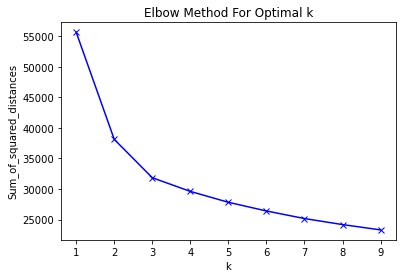

In [83]:
plt.plot(range(1,10), Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

In [84]:
# silhouette analysis
range_n_clusters = [2, 3, 4, 5, 6, 7, 8]

for num_clusters in range_n_clusters:
    
    # intialise kmeans
    kmeans = KMeans(n_clusters=num_clusters, max_iter=50)
    kmeans.fit(X_std)
    
    cluster_labels = kmeans.labels_
    
    # silhouette score
    silhouette_avg = silhouette_score(X_std, cluster_labels)
    print("For n_clusters={0}, the silhouette score is {1}".format(num_clusters, silhouette_avg))

For n_clusters=2, the silhouette score is 0.28612036284428827
For n_clusters=3, the silhouette score is 0.223471101906821
For n_clusters=4, the silhouette score is 0.19017923939872947
For n_clusters=5, the silhouette score is 0.19160072355008478
For n_clusters=6, the silhouette score is 0.19257162769585828
For n_clusters=7, the silhouette score is 0.16405392859846157
For n_clusters=8, the silhouette score is 0.15207748725569212


The best performing silhouette score is achieved with n_clusters=2. 
We know there is some heavy binary tendancies in several features, so is that an artifact of the "True/False" influence? Let's use 3 clusters to see if anything meaningful occurs.

In [97]:
# Defining the k-means
kmeans = KMeans(n_clusters=3, random_state=123)

# Fit model
%timeit kmeans.fit(X_std)
y_pred = kmeans.predict(X_std)

121 ms ± 9.13 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [98]:
# assign the label
df_life['cluster_id'] = kmeans.labels_
df_life.head()

,winsorized_adult_mortality,winsorized_infant_deaths,winsorized_alcohol,winsorized_perc_exp,winsorized_hep_b,winsorized_measles,winsorized_under_five_deaths,winsorized_polio,winsorized_tot_exp,winsorized_diphtheria,winsorized_hiv_aids,winsorized_gdp,winsorized_thinness_1_19,winsorized_thinness_5_9,winsorized_income_composition_of_res,winsorized_schooling,year,status,country,life_exp_bin,cluster_id
0,263.00,55.00,0.01,71.28,65.00,843.00,66.00,51.00,8.16,65.00,0.10,584.26,14.60,15.00,0.48,10.10,2015,0,Afghanistan,2,1
1,271.00,55.00,0.01,73.52,62.00,492.00,66.00,58.00,8.18,62.00,0.10,612.70,14.60,15.00,0.48,10.00,2014,0,Afghanistan,1,1
2,268.00,55.00,0.01,73.22,64.00,430.00,66.00,62.00,8.13,64.00,0.10,631.74,14.60,15.00,0.47,9.90,2013,0,Afghanistan,1,1
3,272.00,55.00,0.01,78.18,67.00,843.00,66.00,67.00,8.52,67.00,0.10,669.96,14.60,15.00,0.46,9.80,2012,0,Afghanistan,1,1
4,275.00,55.00,0.01,7.10,68.00,843.00,66.00,68.00,7.87,68.00,0.10,63.54,14.60,15.00,0.45,9.50,2011,0,Afghanistan,1,1


In [99]:
print("Silhouette score for three cluster k-means: {}".format(
    metrics.silhouette_score(X_std, y_pred, metric='euclidean')))

Silhouette score for three cluster k-means: 0.223471101906821


Before moving on to visualizing clusters with dimensionality reduction, let's take a look at some features when they are grouped by the assigned cluster_id. Can we learn anything about the nature of the clusters by viewing data in the manner?

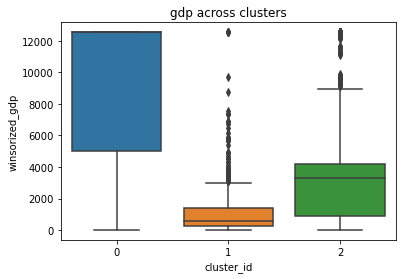

In [88]:
sns.boxplot(x='cluster_id', y='winsorized_gdp', data=df_life)
plt.title('gdp across clusters')
plt.show()

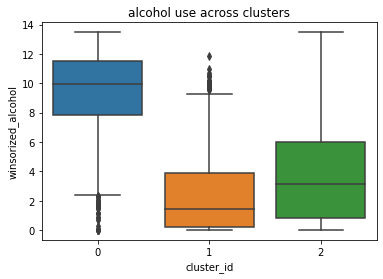

In [89]:
sns.boxplot(x='cluster_id', y='winsorized_alcohol', data=df_life)
plt.title('alcohol use across clusters')
plt.show()

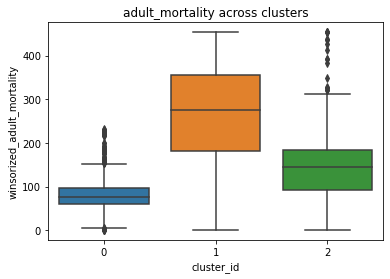

In [90]:
sns.boxplot(x='cluster_id', y='winsorized_adult_mortality', data=df_life)
plt.title('adult_mortality across clusters')
plt.show()

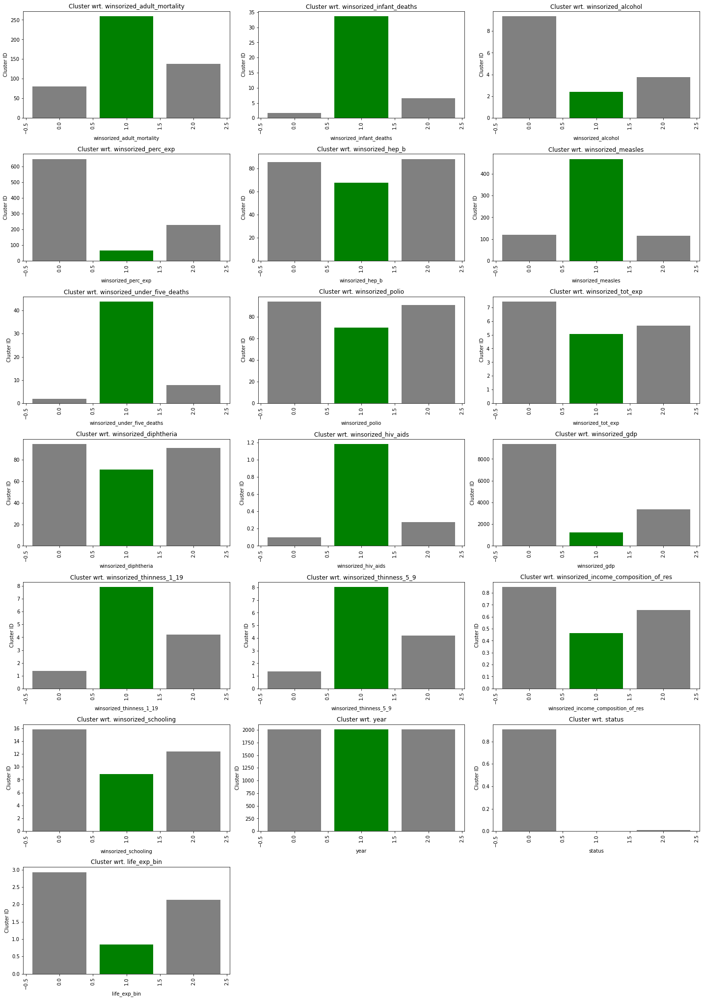

In [91]:
plt.figure(figsize=(20,60))

for index, column in enumerate(df_life[feature_list].columns):
    plt.subplot(15,3,index+1)
    plt.bar(df_life.groupby('cluster_id')[column].mean().index, df_life.groupby('cluster_id')[column].mean(),
           color=("grey","green"))
    plt.title("Cluster wrt. {}".format(column))
    plt.ylabel("Cluster ID")
    plt.xlabel(column)
    plt.xticks(rotation='vertical')

plt.tight_layout()
plt.show()

We can see that there are some discrete and subtle differences between the clusters. For example, cluster 0 has the highest GDP and average life expectancy; while cluster 1 has the lowest GDP and average life expectancy. Cluster 0 and 1 seem to be almost polar opposites when comparing the features in this model. Cluster 1 and 2 appear to be a mix between stark differences and slight variations, depending on the feature. It would also appear that Cluster 0 and 2 have a similar relationship. 

One could argue that 2 clusters would be enough but how does that data look when we use dimensionality reduction methods?

### K-means PCA

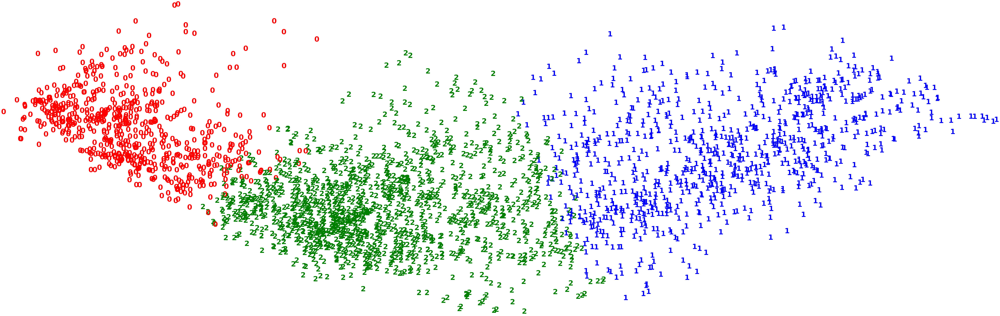

In [92]:
pca = PCA(n_components=2).fit_transform(X_std)

plt.figure(figsize=(10,5))
colours = ["r","b","g","c","k","m"]
#plt.scatter(pca[:,0], pca[:,1])
for i in range(pca.shape[0]):       
    plt.text(pca[i, 0], pca[i, 1], str(y_pred[i]),
             color=colours[int(y_pred[i])],
             fontdict={'weight': 'bold', 'size': 50}
        )
#,"c","m","y","k","burlywood","chartreuse"
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

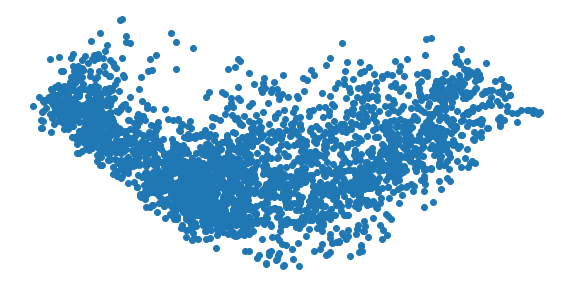

In [93]:
plt.figure(figsize=(10,5))
plt.scatter(pca[:, 0], pca[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

### K-means UMAP

In [94]:
time_start = time.time()

umap_results = umap.UMAP(n_neighbors=7,
                      min_dist=0.4,
                      metric='correlation').fit_transform(X_std)

print('UMAP done! Time elapsed: {} seconds'.format(time.time()-time_start))

UMAP done! Time elapsed: 18.563501596450806 seconds


In [95]:
plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(umap_results.shape[0]):
    plt.text(umap_results[i, 0], umap_results[i, 1], y_pred[i],
             color=colours[int(y_pred[i])],
             fontdict={'weight': 'bold', 'size': 80}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

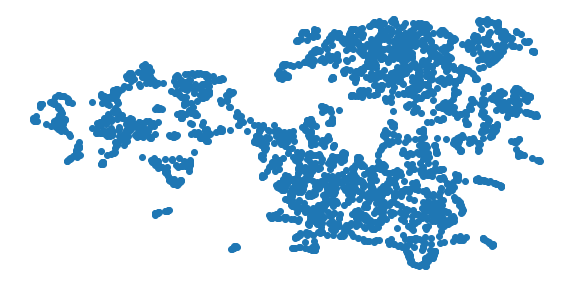

In [96]:
plt.figure(figsize=(10,5))
plt.scatter(umap_results[:, 0], umap_results[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

Very interesting! The observations made earlier about the relationships of the clusters appears to be reflected in the above graphs as well. 

First, how well does PCA do compared to UMAP? 
PCA barely shows trends in the data. It certainly isn't able to graphically reflect 3 clusters. It can, however, resemble 2 trends in the data with a gradient change in behavior.

UMAP appears more adept to reflecting 3 unique clusters. Clusters 0 and 1 are represented as quite different, while cluster 2 appears to be somewhere in between, with a closer relationship with cluster 1. Notice, clusters 0 and 1 do not appear to cross over into eachother's grouping. Whereas cluster 2 shares similarities in the other clusters, while also maintaining a close grouping by itself. 

Based on how well UMAP can distinguish the 3 clusters, my recommendation would be to continue using UMAP instead of PCA in this data set. 

Before we move on to the other clustering algorithms, let's visualize 2 clusters for a sanity check.

In [100]:
# Defining the k-means
kmeans = KMeans(n_clusters=2, random_state=123)

# Fit model
%timeit kmeans.fit(X_std)
y_pred = kmeans.predict(X_std)

86.1 ms ± 3.37 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [101]:
plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(umap_results.shape[0]):
    plt.text(umap_results[i, 0], umap_results[i, 1], y_pred[i],
             color=colours[int(y_pred[i])],
             fontdict={'weight': 'bold', 'size': 80}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

The above graph could suggest that 2 clusters do a fine job at grouping the data. 2 clusters also have the highest silhouette score. Why would we consider using 3 clusters instead of 2? I think it depends on what the question is. If you're looking to model developed vs developing countries, 2 clusters might be the way to go. One could argue that if the target has more than 2 categories, then perhaps using n_clusters=3 (or more) might be the way to go. 

My eyes are still drawn to that thin sliver of '1's that seem to connect 2 bigger groups of clusters. My instinct, in this case is to continue on with 3 clusters. No matter how we slice it, we can sill 2 stark differences in the data, and mixture of the 2 in the middle. That could suggest it's in own class.

### Hierarchical clustering

First, let's compare linkage models to determine best performance.

In [118]:
# Defining the agglomerative clustering - complete
agg_cluster = AgglomerativeClustering(linkage='complete', 
                                      affinity='cosine',
                                      n_clusters=3)

# Fit model
clusters = agg_cluster.fit_predict(X_std)

print("The silhoutte score of linkage method complete: {}"
      .format(metrics.silhouette_score(X_std, clusters, metric='euclidean')))

print('---------------------------------------------------------')

# Defining the agglomerative clustering - average
agg_cluster = AgglomerativeClustering(linkage='average', 
                                      affinity='cosine',
                                      n_clusters=3)

# Fit model
clusters = agg_cluster.fit_predict(X_std)

print("The silhoutte score of linkage method average: {}"
      .format(metrics.silhouette_score(X_std, clusters, metric='euclidean')))

print('---------------------------------------------------------')


# Defining the agglomerative ward
agg_cluster = AgglomerativeClustering(linkage='ward', 
                                      affinity='euclidean',
                                      n_clusters=3)

# Fit model
clusters = agg_cluster.fit_predict(X_std)

print("The silhoutte score of linkage method ward: {}"
      .format(metrics.silhouette_score(X_std, clusters, metric='euclidean')))

The silhoutte score of linkage method complete: 0.13780240927775736
---------------------------------------------------------
The silhoutte score of linkage method average: 0.10530007043743399
---------------------------------------------------------
The silhoutte score of linkage method ward: 0.2022146016162776


The ward method seems to have the highest silhoutte score!
Reminder: we aren't reviewing ARI scores because we really don't have a target feature in this unsupervised workflow. It's a bit more complex than the clean, IRIS dataset.

In [132]:
# Defining the agglomerative clustering
agg_cluster = AgglomerativeClustering(linkage='ward', 
                                      affinity='euclidean',
                                      n_clusters=3)

# Fit model
%timeit agg_cluster.fit(X_std)
clusters = agg_cluster.fit_predict(X_std)

314 ms ± 17 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


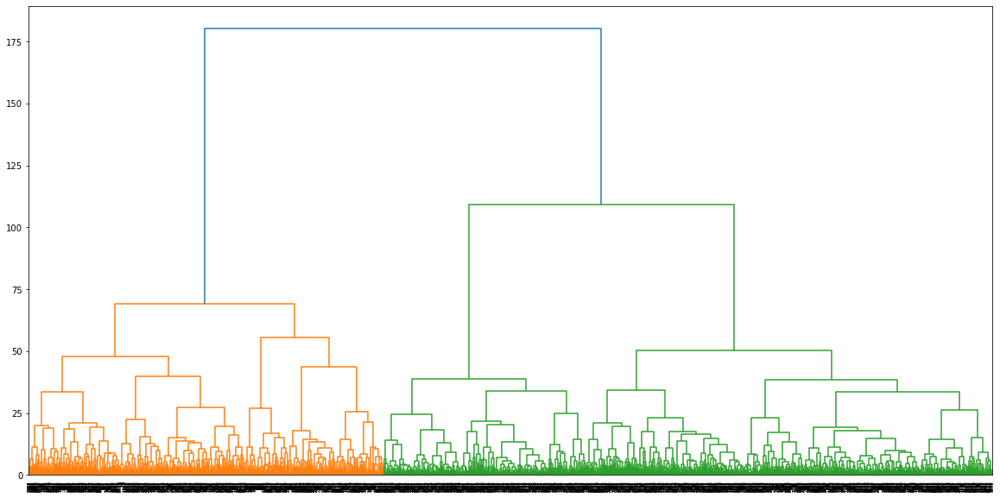

In [121]:
# Dendrogram visualization
plt.figure(figsize=(20,10))
dendrogram(linkage(X_std, method='ward', n_clusters=3))
plt.show()

We can see a common theme of how the clusters are grouping up using the dendrogram as well. Depending on the intended target, it could be up for debate whether 2 or 3 clusters are more appropriate.

### Hierarchical PCA

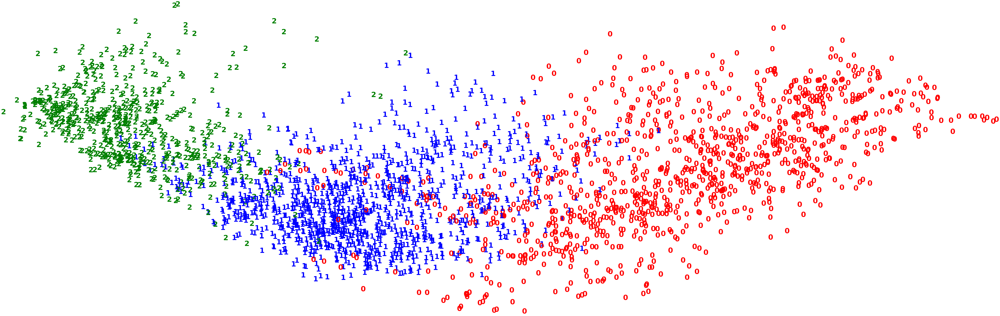

In [124]:
pca = PCA(n_components=2).fit_transform(X_std)

plt.figure(figsize=(10,5))
colours = ["r","b","g","c","k","m"]
#plt.scatter(pca[:,0], pca[:,1])
for i in range(pca.shape[0]):       
    plt.text(pca[i, 0], pca[i, 1], str(clusters[i]),
             color=colours[int(clusters[i])],
             fontdict={'weight': 'bold', 'size': 50}
        )
#,"c","m","y","k","burlywood","chartreuse"
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

### Hierarchical UMAP

In [126]:
time_start = time.time()

umap_results = umap.UMAP(n_neighbors=7,
                      min_dist=0.4,
                      metric='correlation').fit_transform(X_std)

print('UMAP done! Time elapsed: {} seconds'.format(time.time()-time_start))

UMAP done! Time elapsed: 9.350237607955933 seconds


In [127]:
plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(umap_results.shape[0]):
    plt.text(umap_results[i, 0], umap_results[i, 1], clusters[i],
             color=colours[int(clusters[i])],
             fontdict={'weight': 'bold', 'size': 80}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

At first glance, it almost looks like hierarchical clustering does a better job at defining the 3 clusters than K-means. Meaning, it seems like there are fewer cross over classifications within each group. 


- Hierarchical and K-means' silhoutte scores are 0.20 and 0.22, respectively. In this case, K-means gains a slight performance advantage. 
- Hierarchical and K-means' run times are 314 ms ± 17 ms per loop and 121 ms ± 9.13 ms per loop, respectively.
- Hierarchical and K-means' UMAP run times are 9.35 sec and 18.5 sec, respectively.

There appears to be some trade off with each method, so far. K-means clustering is faster and has a higher silhoutte score but hierarchical clustering appears to define the clusters a bit better...based on UMAP visualizations. 

## DBSCAN Clustering

Similarly to hierarchical clustering, let's try some parameter options with DBSCAN. There were a few different methods attempted.

### Method 1

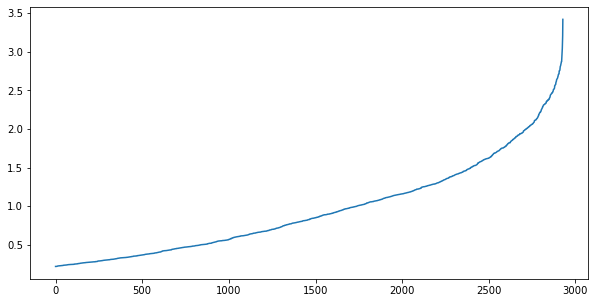

In [144]:
# elbow method

plt.figure(figsize=(10,5))
nn = NearestNeighbors(n_neighbors=5).fit(X_std)
distances, idx = nn.kneighbors(X_std)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)
plt.show()

In [145]:
db = DBSCAN(eps=2, min_samples=6).fit(X_std)
labels = db.labels_
# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)
print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(X_std, labels))

Estimated number of clusters: 29
Estimated number of noise points: 591
Silhouette Coefficient: -0.117


We can try to thumb through different combinations of eps and min_sample values but that might take a while.

### Method 2
Another method to find the best parameter values is to iterate through various eps and min_sample values that can give us our best silhoutte score.

In [309]:
# setting up ranges of values to iterate through (exclusive)
# be careful, if any combination results in 1 cluster, the for loop will return an error...kind of a pain
eps_values = np.arange(1,4,1) 
min_samples = np.arange(2,17,1) 

# combines both lists
dbscan_params = list(product(eps_values, min_samples))

# create blank lists for future appending
no_of_clusters = []
sil_score = []
epsvalues = []
min_samp = []


In [311]:
# for loop that iterates clusters using the dbscan_params list
for p in dbscan_params:
    dbscan_cluster = DBSCAN(eps=p[0], min_samples=p[1], metric="euclidean").fit(X_std)
    epsvalues.append(p[0])
    min_samp.append(p[1])
    no_of_clusters.append(len(np.unique(dbscan_cluster.labels_)))
    sil_score.append(silhouette_score(X_std, dbscan_cluster.labels_, metric="euclidean"))
    
#dbscan_cluster = DBSCAN(eps=1, min_samples=1, metric="euclidean")

# Fit model
#clusters = dbscan_cluster.fit_predict(X_std)

In [312]:
eps_min = list(zip(no_of_clusters, sil_score, epsvalues, min_samp))
eps_min_df = pd.DataFrame(eps_min, columns=['no_of_clusters', 'silhouette_score', 'epsilon_values', 'minimum_points'])
eps_min_df

,no_of_clusters,silhouette_score,epsilon_values,minimum_points
0,455,-0.01,1,2
1,229,-0.16,1,3
2,125,-0.27,1,4
3,77,-0.33,1,5
4,43,-0.35,1,6
5,22,-0.36,1,7
6,13,-0.33,1,8
7,9,-0.27,1,9
8,7,-0.25,1,10
9,6,-0.27,1,11


Not really looking too great in terms of sil_scores. Let's try the best combination that leaves us with 3 clusters, like the previous clustering models.

In [333]:
# Defining the agglomerative clustering
dbscan_cluster = DBSCAN(eps=3, min_samples=15)

# Fit model
clusters = dbscan_cluster.fit_predict(X_std)

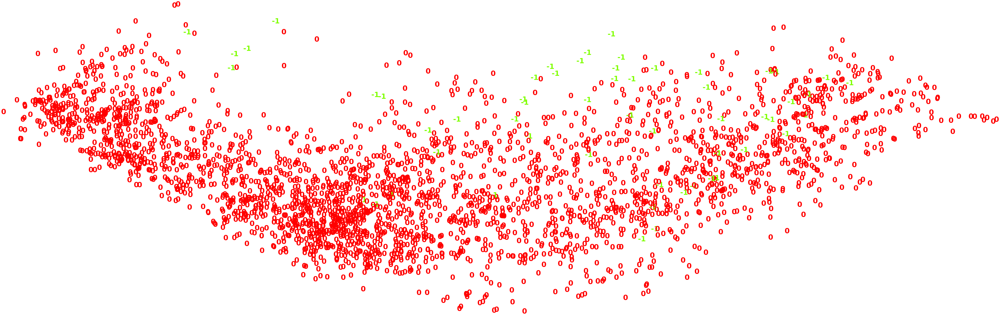

In [334]:
pca = PCA(n_components=2).fit_transform(X_std)

plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
#plt.scatter(pca[:,0], pca[:,1])
for i in range(pca.shape[0]):       
    plt.text(pca[i, 0], pca[i, 1], str(clusters[i]),
             color=colours[int(clusters[i])],
             fontdict={'weight': 'bold', 'size': 50}
        )
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

Ok, so maybe it's not all about the score...

### Method 3

In [335]:
dbscan_cluster = DBSCAN(eps=1, min_samples=1, metric="euclidean")

# Fit model
clusters = dbscan_cluster.fit_predict(X_std)

print("Number of clusters when min_samples=1 is: {}".format(len(np.unique(clusters))))

min_samples_list = range(2,10)

for i in range(2,51):
    dbscan_cluster = DBSCAN(eps=1, min_samples=i, metric="euclidean")
    # Fit model
    clusters = dbscan_cluster.fit_predict(X_std)
    print("Number of clusters when min_samples={} is: {}".format(i, len(np.unique(clusters))))

Number of clusters when min_samples=1 is: 1643
Number of clusters when min_samples=2 is: 455
Number of clusters when min_samples=3 is: 229
Number of clusters when min_samples=4 is: 125
Number of clusters when min_samples=5 is: 77
Number of clusters when min_samples=6 is: 43
Number of clusters when min_samples=7 is: 22
Number of clusters when min_samples=8 is: 13
Number of clusters when min_samples=9 is: 9
Number of clusters when min_samples=10 is: 7
Number of clusters when min_samples=11 is: 6
Number of clusters when min_samples=12 is: 4
Number of clusters when min_samples=13 is: 4
Number of clusters when min_samples=14 is: 3
Number of clusters when min_samples=15 is: 2
Number of clusters when min_samples=16 is: 2
Number of clusters when min_samples=17 is: 1
Number of clusters when min_samples=18 is: 1
Number of clusters when min_samples=19 is: 1
Number of clusters when min_samples=20 is: 1
Number of clusters when min_samples=21 is: 1
Number of clusters when min_samples=22 is: 1
Number

Looks like we get 3 clusters if eps=1 and min_samples = 14.
Let's repeat this method for eps, while using min_samples=14

In [344]:
dbscan_cluster = DBSCAN(eps=1, min_samples=1, metric="euclidean")

# Fit model
clusters = dbscan_cluster.fit_predict(X_std)

print("Number of clusters when eps=1 is: {}".format(len(np.unique(clusters))))

min_samples_list = range(2,51)

for i in [0.01,0.1,1,2,3,3.5,4,5,6,7,8,9,10]:
    dbscan_cluster = DBSCAN(eps=i, min_samples=14, metric="euclidean")
    # Fit model
    clusters = dbscan_cluster.fit_predict(X_std)
    print("Number of clusters when eps={} is: {}".format(i, len(np.unique(clusters))))

Number of clusters when eps=1 is: 1643
Number of clusters when eps=0.01 is: 1
Number of clusters when eps=0.1 is: 1
Number of clusters when eps=1 is: 3
Number of clusters when eps=2 is: 12
Number of clusters when eps=3 is: 2
Number of clusters when eps=3.5 is: 2
Number of clusters when eps=4 is: 1
Number of clusters when eps=5 is: 1
Number of clusters when eps=6 is: 1
Number of clusters when eps=7 is: 1
Number of clusters when eps=8 is: 1
Number of clusters when eps=9 is: 1
Number of clusters when eps=10 is: 1


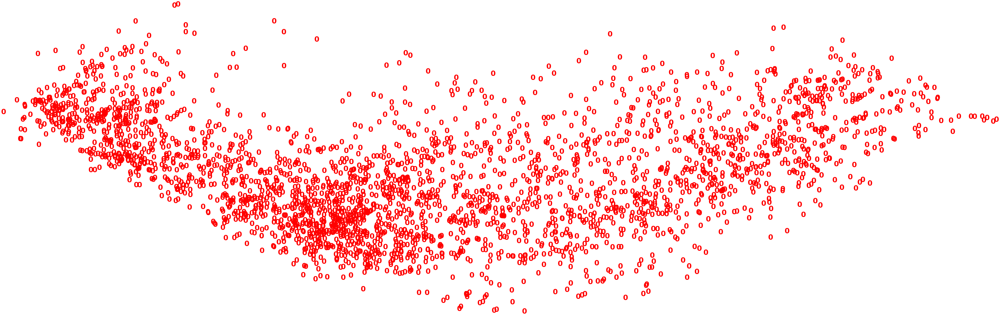

In [342]:
pca = PCA(n_components=2).fit_transform(X_std)

plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
#plt.scatter(pca[:,0], pca[:,1])
for i in range(pca.shape[0]):       
    plt.text(pca[i, 0], pca[i, 1], str(clusters[i]),
             color=colours[int(clusters[i])],
             fontdict={'weight': 'bold', 'size': 50}
        )
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

### Method 4, which is a continuation of Method 1.

(Bangs head against desk)
Clearly, we need to take a different approach.
We know that eps determines the size of the neighborhood and the min_samples determines number of samples to look at in that neighborhood. Too large an eps value, and we lose all definition in the data. Same goes for min_samples. This eval method is quite tedious and iterative. The best solution I have found is eps=2 and min_samples=22.

Caution, silhoutte score is a difficult sell.

In [345]:
# Defining the agglomerative clustering
dbscan_cluster = DBSCAN(eps=2, min_samples=22)

# Fit model
clusters = dbscan_cluster.fit_predict(X_std)

In [353]:
print("The silhoutte score of the DBSCAN solution: {}"
      .format(metrics.silhouette_score(X_std, clusters, metric='euclidean')))

The silhoutte score of the DBSCAN solution: -0.02559471483053089


### DBSCAN PCA

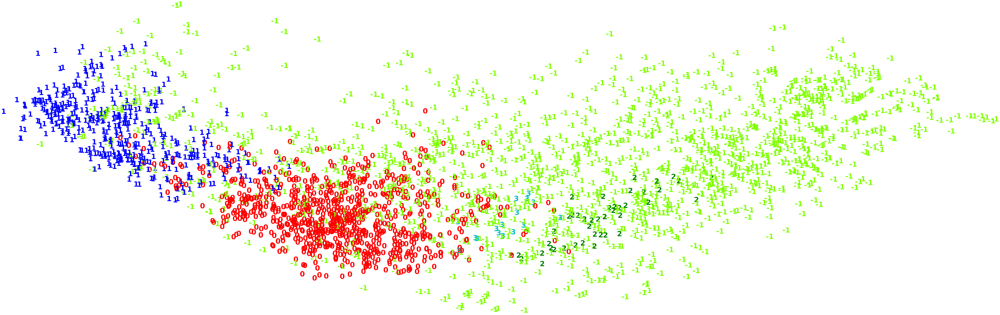

In [347]:
pca = PCA(n_components=2).fit_transform(X_std)

plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
#plt.scatter(pca[:,0], pca[:,1])
for i in range(pca.shape[0]):       
    plt.text(pca[i, 0], pca[i, 1], str(clusters[i]),
             color=colours[int(clusters[i])],
             fontdict={'weight': 'bold', 'size': 50}
        )
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

### DBSCAN UMAP

In [349]:
time_start = time.time()

umap_results = umap.UMAP(n_neighbors=7,
                      min_dist=0.4,
                      metric='correlation').fit_transform(X_std)

print('UMAP done! Time elapsed: {} seconds'.format(time.time()-time_start))

UMAP done! Time elapsed: 9.705603122711182 seconds


In [350]:
plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(umap_results.shape[0]):
    plt.text(umap_results[i, 0], umap_results[i, 1], clusters[i],
             color=colours[int(clusters[i])],
             fontdict={'weight': 'bold', 'size': 80}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

I give up on DBSCAN for this data set. There were different methods attempted to find the right parameters but it's possible that the structure of this data is incompatable with DBSCAN.
Review the UMAP plot. The majority of grouped cluster in the far right is considered noise by this model, which disagrees with the 2 previous clustering models. The silhoutte score of the DBSCAN solution is -0.025... which is far worse than both previous methods. 
DBSCAN is not recommended with this data.

### Gaussian Mixture Model (GMM)

Let's try to find a good n_component to use.

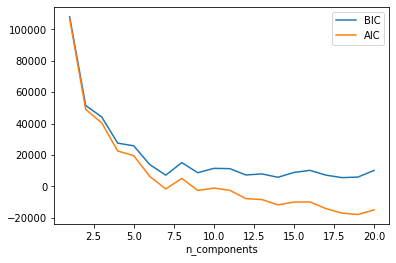

In [376]:
n_components = np.arange(1, 21)
models = [GaussianMixture(n, covariance_type='full', random_state=123).fit(X_std)
          for n in n_components]

plt.plot(n_components, [m.bic(X_std) for m in models], label='BIC')
plt.plot(n_components, [m.aic(X_std) for m in models], label='AIC')
plt.legend(loc='best')
plt.xlabel('n_components');

In [392]:
# Defining the agglomerative clustering
gmm_cluster = GaussianMixture(n_components=3, covariance_type="full", random_state=123)

# Fit model
clusters = gmm_cluster.fit_predict(X_std)

In [393]:
print("The silhoutte score of the GMM solution: {}"
      .format(metrics.silhouette_score(X_std, clusters, metric='euclidean')))

The silhoutte score of the GMM solution: 0.15516268405176908


### GMM PCA

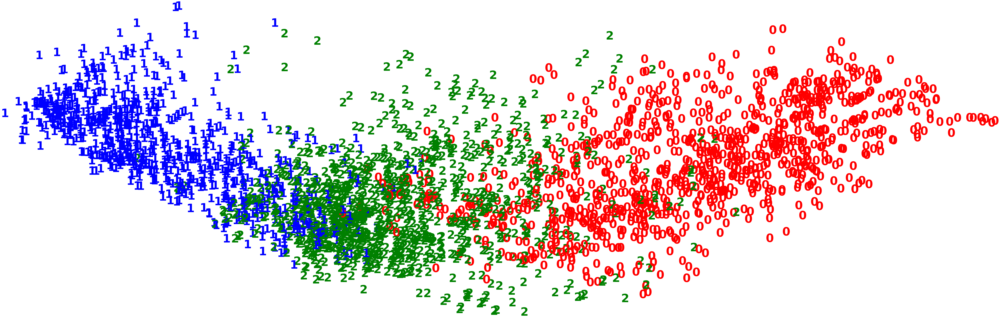

In [394]:
pca = PCA(n_components=2).fit_transform(X_std)

plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(pca.shape[0]):
    plt.text(pca[i, 0], pca[i, 1], str(clusters[i]),
             color=colours[int(clusters[i])],
             fontdict={'weight': 'bold', 'size': 80}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

### GMM probabilistic plot

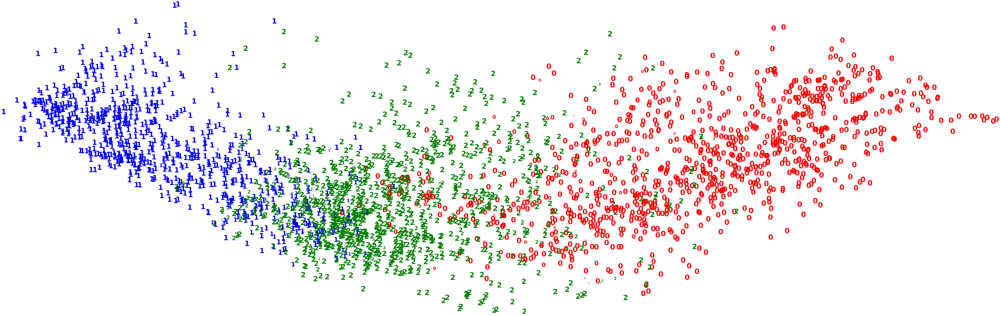

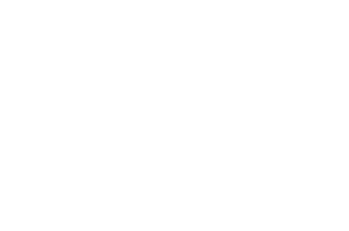

In [395]:
probs = gmm_cluster.predict_proba(X_std)

size = 50 * probs.max(1) ** 2  # square emphasizes differences

plt.figure(figsize=(10,5))
colours = 'rbg'
for i in range(pca.shape[0]):
    plt.text(pca[i, 0], pca[i, 1], str(clusters[i]),
             color=colours[clusters[i]],
             fontdict={'weight': 'bold', 'size': size[i]}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

### GMM UMAP

In [407]:
time_start = time.time()

umap_results = umap.UMAP(n_neighbors=7,
                      min_dist=0.4,
                      metric='correlation').fit_transform(X_std)

print('UMAP done! Time elapsed: {} seconds'.format(time.time()-time_start))

UMAP done! Time elapsed: 8.380249500274658 seconds


In [408]:
plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(umap_results.shape[0]):
    plt.text(umap_results[i, 0], umap_results[i, 1], clusters[i],
             color=colours[int(clusters[i])],
             fontdict={'weight': 'bold', 'size': 80}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

In summary, utilizing K-means clustering and UMAP dimensionality reduction methods seem to be the best bargain for deriving insights about the data. We finished up with GMM, which wasn't the worst model attempted in this challenge. However, the clarity of the cluster groups was lacking compared to both K-means and hierarchical methods. 

As it was demonstrated earlier, clustering can be a powerful tool to group multidimentional data to determine what might be similar within the data. Assigning clusters to each row allows for a new way to group the data, which can allow statistical relationships to triumph over biases. Once the clusters and features are appropriately explored, then the next step would include further feature selection methods and predictions with supervised learning methods.